# **Deep Learning and its Applications to Signal and Image Processing and Analysis** - 361.2.1120

## **Final Project**

**Submitted by:** Anastasia Ivanovski and May Yarden

# Setup

In [ ]:
!nvidia-smi

Tue Jul  8 07:42:53 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA L4                      Off |   00000000:00:03.0 Off |                    0 |
| N/A   68C    P8             15W /   72W |       0MiB /  23034MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [ ]:
!pip install pytorch-lightning
!pip install torch-fidelity

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 825.4/825.4 kB 20.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 128.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 101.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 69.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 43.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 110.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 963.5/963.5 kB 71.6 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitl

In [ ]:
import glob
import os
import shutil

import matplotlib.pyplot as plt
import numpy as np
import pytorch_lightning as L
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as T
from pytorch_lightning.utilities import CombinedLoader
from torch import nn
from torch.utils.data import DataLoader, Dataset
from torchvision.io import read_image
from torchvision.utils import make_grid, save_image
from PIL import Image
from pytorch_lightning.callbacks import ModelCheckpoint
from torchmetrics.image.mifid import MemorizationInformedFrechetInceptionDistance

_ = L.seed_everything(0, workers=True)

INFO:lightning_fabric.utilities.seed:Seed set to 0


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

# Data loading

## Dataset modules and functions

In [ ]:
def show_img(img_tensor, nrow, title=""):
    img_tensor = img_tensor.detach().cpu() * 0.5 + 0.5
    img_grid = make_grid(img_tensor, nrow=nrow).permute(1, 2, 0)
    plt.figure(figsize=(18, 8))
    plt.imshow(img_grid)
    plt.axis("off")
    plt.title(title)
    plt.show()

class CustomTransform(object):
    def __init__(self, load_dim=286, target_dim=256):
        self.transform_train = T.Compose([
            T.Resize((load_dim, load_dim), antialias=True),
            T.RandomCrop((target_dim, target_dim)),
            T.RandomHorizontalFlip(p=0.5),
            T.ColorJitter(brightness=0.2, contrast=0.2,
                          saturation=0.2, hue=0.1),
        ])

        self.transform = T.Resize((target_dim, target_dim), antialias=True)

    def __call__(self, img, stage):
        if stage == "fit":
            img = self.transform_train(img)
        else:
            img = self.transform(img)
        return img * 2 - 1

class CustomDataset(Dataset):
    def __init__(self, filenames, transform, stage):
        self.filenames = filenames
        self.transform = transform
        self.stage = stage

    def __len__(self):
        return len(self.filenames)

    def __getitem__(self, idx):
        img_name = self.filenames[idx]
        img = read_image(img_name) / 255.0
        return self.transform(img, stage=self.stage)


class CustomDataModule(L.LightningDataModule):
    def __init__(
        self,
        monet_dir,
        photo_dir,
        loader_config,
        sample_size,
        batch_size,
    ):
        super().__init__()
        self.loader_config = loader_config
        self.sample_size = sample_size
        self.batch_size = batch_size

        self.monet_filenames = sorted(glob.glob(os.path.join(monet_dir, "*.jpg")))
        self.photo_filenames = sorted(glob.glob(os.path.join(photo_dir, "*.jpg")))

        self.transform = CustomTransform()

    def setup(self, stage):
        if stage == "fit":
            self.train_monet = CustomDataset(self.monet_filenames, self.transform, stage)
            self.train_photo = CustomDataset(self.photo_filenames, self.transform, stage)

        if stage in ["fit", "test", "predict"]:
            self.valid_photo = CustomDataset(self.photo_filenames, self.transform, None)

    def train_dataloader(self):
        loader_config = {
            "shuffle": True,
            "drop_last": True,
            "batch_size": self.batch_size,
            "num_workers": 11,
            **self.loader_config,
        }
        loader_monet = DataLoader(self.train_monet, **loader_config)
        loader_photo = DataLoader(self.train_photo, **loader_config)
        loaders = {"monet": loader_monet, "photo": loader_photo}
        return CombinedLoader(loaders, mode="max_size_cycle")

    def val_dataloader(self):
        return DataLoader(
            self.valid_photo,
            batch_size=self.sample_size,
            **self.loader_config,
        )

    def test_dataloader(self):
        return self.val_dataloader()

    def predict_dataloader(self):
        return DataLoader(
            self.valid_photo,
            batch_size=self.batch_size,
            **self.loader_config,
        )

## Dataset loading config

In [ ]:
DM_CONFIG = {
    # the directories where the Monet paintings and photos are loaded from
    "monet_dir": os.path.join("/content/monet_jpg"),
    "photo_dir": os.path.join("/content/photo_jpg"),


    "loader_config": {
        "num_workers": 11,
        "pin_memory": torch.cuda.is_available(),
    },

    # the validation/test batch size
    "sample_size": 5,

    # the training/prediction batch size
    "batch_size": 1,
}

## Downloading dataset from competition page

key in json format is required

In [ ]:
from google.colab import files
files.upload()

!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

!kaggle competitions download -c gan-getting-started
!unzip gan-getting-started.zip

Streaming output truncated to the last 5000 lines.
  inflating: photo_jpg/46e71a4094.jpg  
  inflating: photo_jpg/46e84039a1.jpg  
  inflating: photo_jpg/46f391abec.jpg  
  inflating: photo_jpg/46f5ef1042.jpg  
  inflating: photo_jpg/4706619607.jpg  
  inflating: photo_jpg/4707b03a08.jpg  
  inflating: photo_jpg/47100a9939.jpg  
  inflating: photo_jpg/471f4755b9.jpg  
  inflating: photo_jpg/472b351bc4.jpg  
  inflating: photo_jpg/472d5ac100.jpg  
  inflating: photo_jpg/4758e5dd4c.jpg  
  inflating: photo_jpg/4762bb79ef.jpg  
  inflating: photo_jpg/4778b13518.jpg  
  inflating: photo_jpg/4787b82d37.jpg  
  inflating: photo_jpg/478e07feaa.jpg  
  inflating: photo_jpg/478eb12a82.jpg  
  inflating: photo_jpg/479698b371.jpg  
  inflating: photo_jpg/4796d67f61.jpg  
  inflating: photo_jpg/47aad493bd.jpg  
  inflating: photo_jpg/47ae0edd23.jpg  
  inflating: photo_jpg/47b94957ff.jpg  
  inflating: photo_jpg/47bb43fe3e.jpg  
  inflating: photo_jpg/47bb59d449.jpg  
  inflating: photo_jpg/47d391

## Sampling for visualization

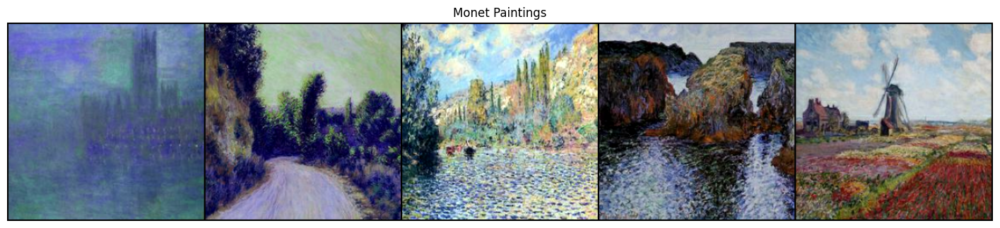

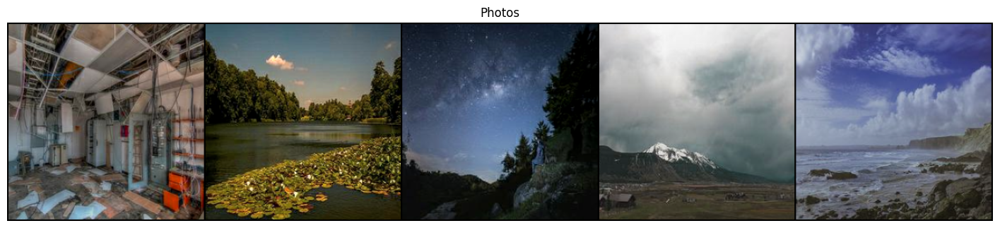

In [ ]:
dm_sample = CustomDataModule(batch_size=5, **{k: v for k, v in DM_CONFIG.items() if k != "batch_size"})
dm_sample.setup("fit")

train_loader = dm_sample.train_dataloader()
imgs = next(iter(train_loader))

imgs_dict = imgs[0]  # This is {'monet': ..., 'photo': ...}
monet_imgs = imgs_dict['monet']
photo_imgs = imgs_dict['photo']

show_img(monet_imgs, nrow=5, title="Monet Paintings")
show_img(photo_imgs, nrow=5, title="Photos")

In [ ]:
monet_imgs[0].size()

torch.Size([3, 256, 256])

In [ ]:
# MONET_FILENAMES = tf.io.gfile.glob(str('/content/monet_tfrec/*.tfrec'))
# print('Monet TFRecord Files:', len(MONET_FILENAMES))
# PHOTO_FILENAMES = tf.io.gfile.glob(str('/content/photo_tfrec/*.tfrec'))
# print('Photo TFRecord Files:', len(PHOTO_FILENAMES))

# Baseline - CycleGAN

## Downsampling

In [ ]:
class Downsampling(nn.Module):
    def __init__(
        self,
        in_channels,
        out_channels,
        kernel_size=4,
        stride=2,
        padding=1,
        norm=True,
        lrelu=True,
    ):
        super().__init__()
        self.block = nn.Sequential(
            nn.Conv2d(in_channels, out_channels,
                      kernel_size=kernel_size, stride=stride, padding=padding, bias=not norm),
        )
        if norm:
            self.block.append(nn.InstanceNorm2d(out_channels, affine=True))
        if lrelu is not None:
            self.block.append(nn.LeakyReLU(0.2, True) if lrelu else nn.ReLU(True))

    def forward(self, x):
        return self.block(x)

## Upsampling

In [ ]:
class Upsampling(nn.Module):
    def __init__(
        self,
        in_channels,
        out_channels,
        kernel_size=4,
        stride=2,
        padding=1,
        output_padding=0,
        dropout=False,
    ):
        super().__init__()
        self.block = nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels,
                               kernel_size=kernel_size, stride=stride,
                               padding=padding, output_padding=output_padding, bias=False),
            nn.InstanceNorm2d(out_channels, affine=True),
        )
        if dropout:
            self.block.append(nn.Dropout(0.5))
        self.block.append(nn.ReLU(True))

    def forward(self, x):
        return self.block(x)

## Residual block

In [ ]:
class ResBlock(nn.Module):
    def __init__(self, in_channels, kernel_size=3, padding=1):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(padding),
            Downsampling(in_channels, in_channels,
                         kernel_size=kernel_size, stride=1, padding=0, lrelu=False),
            nn.ReflectionPad2d(padding),
            Downsampling(in_channels, in_channels,
                         kernel_size=kernel_size, stride=1, padding=0, lrelu=None),
        )

    def forward(self, x):
        return x + self.block(x)

## Generator

In [ ]:
class UNetGenerator(nn.Module):
    def __init__(self, hid_channels, in_channels, out_channels):
        super().__init__()
        self.downsampling_path = nn.Sequential(
            Downsampling(in_channels, hid_channels, norm=False), # 64x128x128
            Downsampling(hid_channels, hid_channels*2), # 128x64x64
            Downsampling(hid_channels*2, hid_channels*4), # 256x32x32
            Downsampling(hid_channels*4, hid_channels*8), # 512x16x16
            Downsampling(hid_channels*8, hid_channels*8), # 512x8x8
            Downsampling(hid_channels*8, hid_channels*8), # 512x4x4
            Downsampling(hid_channels*8, hid_channels*8), # 512x2x2
            Downsampling(hid_channels*8, hid_channels*8, norm=False), # 512x1x1, instance norm does not work on 1x1
        )
        self.upsampling_path = nn.Sequential(
            Upsampling(hid_channels*8, hid_channels*8, dropout=True), # (512+512)x2x2
            Upsampling(hid_channels*16, hid_channels*8, dropout=True), # (512+512)x4x4
            Upsampling(hid_channels*16, hid_channels*8, dropout=True), # (512+512)x8x8
            Upsampling(hid_channels*16, hid_channels*8), # (512+512)x16x16
            Upsampling(hid_channels*16, hid_channels*4), # (256+256)x32x32
            Upsampling(hid_channels*8, hid_channels*2), # (128+128)x64x64
            Upsampling(hid_channels*4, hid_channels), # (64+64)x128x128
        )
        self.feature_block = nn.Sequential(
            nn.ConvTranspose2d(hid_channels*2, out_channels,
                               kernel_size=4, stride=2, padding=1), # 3x256x256
            nn.Tanh(),
        )

    def forward(self, x):
        skips = []
        for down in self.downsampling_path:
            x = down(x)
            skips.append(x)
        skips = reversed(skips[:-1])

        for up, skip in zip(self.upsampling_path, skips):
            x = up(x)
            x = torch.cat([x, skip], dim=1)
        return self.feature_block(x)


def get_gen(gen_name, hid_channels, num_resblocks, in_channels=3, out_channels=3):
        return UNetGenerator(hid_channels, in_channels, out_channels)

## Discriminator

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, hid_channels, in_channels=3):
        super().__init__()
        self.block = nn.Sequential(
            Downsampling(in_channels, hid_channels, norm=False), # 64x128x128
            Downsampling(hid_channels, hid_channels*2), # 128x64x64
            Downsampling(hid_channels*2, hid_channels*4), # 256x32x32
            Downsampling(hid_channels*4, hid_channels*8, stride=1), # 512x31x31
            nn.Conv2d(hid_channels*8, 1, kernel_size=4, padding=1), # 1x30x30
        )

    def forward(self, x):
        return self.block(x)

## Image buffer

In [ ]:
class ImageBuffer(object):
    def __init__(self, buffer_size):
        self.buffer_size = buffer_size
        if self.buffer_size > 0:
            self.curr_cap = 0
            self.buffer = []

    def __call__(self, imgs):
        if self.buffer_size == 0:
            return imgs

        return_imgs = []
        for img in imgs:
            img = img.unsqueeze(dim=0)

            if self.curr_cap < self.buffer_size:
                self.curr_cap += 1
                self.buffer.append(img)
                return_imgs.append(img)
            else:
                p = np.random.uniform(low=0., high=1.)

                # swap images between input and buffer with probability 0.5
                if p > 0.5:
                    idx = np.random.randint(low=0, high=self.buffer_size)
                    tmp = self.buffer[idx].clone()
                    self.buffer[idx] = img
                    return_imgs.append(tmp)
                else:
                    return_imgs.append(img)
        return torch.cat(return_imgs, dim=0)

## CycleGAN

### CycleGAN model config

In [ ]:
MODEL_CONFIG = {
    "gen_name": "unet",
    "num_resblocks": 6,

    "hid_channels": 64,

    "optimizer": torch.optim.Adam,

    # the learning rate and beta parameters for the Adam optimizer
    "lr": 2e-4,
    "betas": (0.5, 0.999),

    # the weights used in the identity loss and cycle loss
    "lambda_idt": 0.5,
    "lambda_cycle": (10, 10), # (MPM direction, PMP direction)

    # the size of the buffer that stores previously generated images
    "buffer_size": 100,

    "num_epochs": 18,

    # the number of epochs before starting the learning rate decay
    "decay_epochs": 18,
}

### CycleGAN module

In [ ]:
class CycleGAN(L.LightningModule):
    def __init__(
        self,
        gen_name,
        num_resblocks,
        hid_channels,
        optimizer,
        lr,
        betas,
        lambda_idt,
        lambda_cycle,
        buffer_size,
        num_epochs,
        decay_epochs,
    ):
        super().__init__()
        self.save_hyperparameters(ignore=["optimizer"])
        self.optimizer = optimizer
        self.automatic_optimization = False

        self.gen_PM = get_gen(gen_name, hid_channels, num_resblocks)
        self.gen_MP = get_gen(gen_name, hid_channels, num_resblocks)
        self.disc_M = Discriminator(hid_channels)
        self.disc_P = Discriminator(hid_channels)

        # initialize buffers to store fake images
        self.buffer_fake_M = ImageBuffer(buffer_size)
        self.buffer_fake_P = ImageBuffer(buffer_size)

    def forward(self, img):
        return self.gen_PM(img)

    def init_weights(self):
        def init_fn(m):
            if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.InstanceNorm2d)):
                nn.init.normal_(m.weight, 0.0, 0.02)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0.0)

        for net in [self.gen_PM, self.gen_MP, self.disc_M, self.disc_P]:
            net.apply(init_fn)

    def setup(self, stage):
        if stage == "fit":
            self.init_weights()
            print("Model initialized.")

    def get_lr_scheduler(self, optimizer):
        def lr_lambda(epoch):
            len_decay_phase = self.hparams.num_epochs - self.hparams.decay_epochs + 1.0
            curr_decay_step = max(0, epoch - self.hparams.decay_epochs + 1.0)
            val = 1.0 - curr_decay_step / len_decay_phase
            return max(0.0, val)

        return torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lr_lambda)

    def configure_optimizers(self):
        opt_config = {
            "lr": self.hparams.lr,
            "betas": self.hparams.betas,
        }
        opt_gen = self.optimizer(
            list(self.gen_PM.parameters()) + list(self.gen_MP.parameters()),
            **opt_config,
        )
        opt_disc = self.optimizer(
            list(self.disc_M.parameters()) + list(self.disc_P.parameters()),
            **opt_config,
        )
        optimizers = [opt_gen, opt_disc]
        schedulers = [self.get_lr_scheduler(opt) for opt in optimizers]
        return optimizers, schedulers

    def adv_criterion(self, y_hat, y):
        return F.mse_loss(y_hat, y)

    def recon_criterion(self, y_hat, y):
        return F.l1_loss(y_hat, y)

    def get_adv_loss(self, fake, disc):
        fake_hat = disc(fake)
        real_labels = torch.ones_like(fake_hat)
        adv_loss = self.adv_criterion(fake_hat, real_labels)
        return adv_loss

    def get_idt_loss(self, real, idt, lambda_cycle):
        idt_loss = self.recon_criterion(idt, real)
        return self.hparams.lambda_idt * lambda_cycle * idt_loss

    def get_cycle_loss(self, real, recon, lambda_cycle):
        cycle_loss = self.recon_criterion(recon, real)
        return lambda_cycle * cycle_loss

    def get_gen_loss(self):
        # calculate adversarial loss
        adv_loss_PM = self.get_adv_loss(self.fake_M, self.disc_M)
        adv_loss_MP = self.get_adv_loss(self.fake_P, self.disc_P)
        total_adv_loss = adv_loss_PM + adv_loss_MP

        # calculate identity loss
        lambda_cycle = self.hparams.lambda_cycle
        idt_loss_MM = self.get_idt_loss(self.real_M, self.idt_M, lambda_cycle[0])
        idt_loss_PP = self.get_idt_loss(self.real_P, self.idt_P, lambda_cycle[1])
        total_idt_loss = idt_loss_MM + idt_loss_PP

        # calculate cycle loss
        cycle_loss_MPM = self.get_cycle_loss(self.real_M, self.recon_M, lambda_cycle[0])
        cycle_loss_PMP = self.get_cycle_loss(self.real_P, self.recon_P, lambda_cycle[1])
        total_cycle_loss = cycle_loss_MPM + cycle_loss_PMP

        # combine losses
        gen_loss = total_adv_loss + total_idt_loss + total_cycle_loss
        return gen_loss

    def get_disc_loss(self, real, fake, disc):
        # calculate loss on real images
        real_hat = disc(real)
        real_labels = torch.ones_like(real_hat)
        real_loss = self.adv_criterion(real_hat, real_labels)

        # calculate loss on fake images
        fake_hat = disc(fake.detach())
        fake_labels = torch.zeros_like(fake_hat)
        fake_loss = self.adv_criterion(fake_hat, fake_labels)

        # combine losses
        disc_loss = (fake_loss + real_loss) * 0.5
        return disc_loss

    def get_disc_loss_M(self):
        fake_M = self.buffer_fake_M(self.fake_M)
        return self.get_disc_loss(self.real_M, fake_M, self.disc_M)

    def get_disc_loss_P(self):
        fake_P = self.buffer_fake_P(self.fake_P)
        return self.get_disc_loss(self.real_P, fake_P, self.disc_P)

    def training_step(self, batch, batch_idx):
        self.real_M = batch["monet"]
        self.real_P = batch["photo"]
        opt_gen, opt_disc = self.optimizers()

        self.fake_M = self.gen_PM(self.real_P)
        self.fake_P = self.gen_MP(self.real_M)

        self.idt_M = self.gen_PM(self.real_M)
        self.idt_P = self.gen_MP(self.real_P)

        self.recon_M = self.gen_PM(self.fake_P)
        self.recon_P = self.gen_MP(self.fake_M)

        self.toggle_optimizer(opt_gen)
        gen_loss = self.get_gen_loss()
        opt_gen.zero_grad()
        self.manual_backward(gen_loss)
        opt_gen.step()
        self.untoggle_optimizer(opt_gen)

        self.toggle_optimizer(opt_disc)
        disc_loss_M = self.get_disc_loss_M()
        disc_loss_P = self.get_disc_loss_P()
        opt_disc.zero_grad()
        self.manual_backward(disc_loss_M)
        self.manual_backward(disc_loss_P)
        opt_disc.step()
        self.untoggle_optimizer(opt_disc)

        metrics = {
            "gen_loss": gen_loss,
            "disc_loss_M": disc_loss_M,
            "disc_loss_P": disc_loss_P,
        }
        self.log_dict(metrics, on_step=False, on_epoch=True, prog_bar=True)

    def validation_step(self, batch, batch_idx):
        self.display_results(batch, batch_idx, "validate")

    def test_step(self, batch, batch_idx):
        self.display_results(batch, batch_idx, "test")

    def predict_step(self, batch, batch_idx):
        return self(batch)

    def display_results(self, batch, batch_idx, stage):
        real_P = batch
        fake_M = self(real_P)

        if stage == "validate":
            title = f"Epoch {self.current_epoch+1}: Photo-to-Monet Translation"
        else:
            title = f"Sample {batch_idx+1}: Photo-to-Monet Translation"

        show_img(
            torch.cat([real_P, fake_M], dim=0),
            nrow=len(real_P),
            title=title,
        )

    def on_train_epoch_start(self):
        curr_lr = self.lr_schedulers()[0].get_last_lr()[0]
        self.log("lr", curr_lr, on_step=False, on_epoch=True, prog_bar=True)

    def on_train_epoch_end(self):
        for sch in self.lr_schedulers():
            sch.step()

        logged_values = self.trainer.progress_bar_metrics
        print(
            f"Epoch {self.current_epoch+1}",
            *[f"{k}: {v:.5f}" for k, v in logged_values.items()],
            sep=" - ",
        )

    def on_train_end(self):
        print("Training ended.")

    def on_predict_epoch_end(self):
        predictions = self.trainer.predict_loop.predictions
        num_batches = len(predictions)
        batch_size = predictions[0].shape[0]
        last_batch_diff = batch_size - predictions[-1].shape[0]
        print(f"Number of images generated: {num_batches*batch_size-last_batch_diff}.")

## Loading checkpoint

#### Downloading checkpoint file from Kaggle

In [ ]:
checkpoint_path = 'epoch=17-step=253368.ckpt'
!kaggle kernels output chongzhenjie/photo-to-monet-cyclegan-pytorch-lightning -p ./monet_output

Output file downloaded to ./monet_output/checkpoints/epoch=17-step=253368.ckpt
Output file downloaded to ./monet_output/images.zip
Kernel log downloaded to ./monet_output/photo-to-monet-cyclegan-pytorch-lightning.log 


#### Loading checkpoint to the model

In [ ]:
model = CycleGAN.load_from_checkpoint(
    "./monet_output/checkpoints/epoch=17-step=253368.ckpt",
    gen_name="unet",
    num_resblocks=6,
    hid_channels=64,
    optimizer=torch.optim.Adam,
    lr=0.0002,
    betas=(0.5, 0.999),
    lambda_idt=0.5,
    lambda_cycle=(10, 10),
    buffer_size=100,
    num_epochs=18,
    decay_epochs=18
)
model.eval()

CycleGAN(
  (gen_PM): UNetGenerator(
    (downsampling_path): Sequential(
      (0): Downsampling(
        (block): Sequential(
          (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
          (1): LeakyReLU(negative_slope=0.2, inplace=True)
        )
      )
      (1): Downsampling(
        (block): Sequential(
          (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): LeakyReLU(negative_slope=0.2, inplace=True)
        )
      )
      (2): Downsampling(
        (block): Sequential(
          (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): LeakyReLU(negative_slope=0.2, inplace=True)
        )
      )
      (3): Downsampling(
        (block): Sequential(
          

## MiFID - U-Net

In [ ]:
mifid = MemorizationInformedFrechetInceptionDistance(normalize=True).cuda()

In [ ]:
# MiFID expects [0,1] range
transform_monet = T.Compose([
    T.Resize((target_dim, target_dim), antialias=True),
    T.ToTensor()  # values in [0,1]
])

### Loading to MiFID Monet images

In [ ]:
monet_filenames = sorted(glob.glob(os.path.join("/content/monet_jpg", "*.jpg")))

for fname in monet_filenames:
    img = Image.open(fname).convert("RGB")
    img_tensor = transform_monet(img).unsqueeze(0).cuda()
    mifid.update(img_tensor, real=True)

### Loading to MiFID generated images


In [ ]:
output_path = r"/content/generated_monet_UNet/"
os.mkdir(output_path)
photo_filenames = sorted(glob.glob(os.path.join("/content/photo_jpg", "*.jpg")))

for i,fname in enumerate(photo_filenames):
    img = Image.open(fname).convert("RGB")
    img_tensor = transform(img).unsqueeze(0).cuda()

    # Generate Monet-style image using your CycleGAN model
    with torch.no_grad():
        output = model.gen_PM(img_tensor)

    # Ensure output is in [0,1]
    output = (output + 1) / 2
    output = torch.clamp(output, 0, 1)

    save_image(output, f"{output_path}{os.path.basename(fname)}")

    mifid.update(output, real=False)

### Calculate score

In [ ]:
score = mifid.compute()
print("MiFID score:", score.item())

MiFID score: 82.65328979492188


### Save to zip in google drive

In [ ]:
!zip -r /content/generated_monet_UNet.zip /content/generated_monet_UNet/
!cp /content/generated_monet_UNet.zip /content/gdrive/MyDrive/ColabCheckpoints/

Streaming output truncated to the last 5000 lines.
  adding: content/generated_monet_UNet/5c50599656.jpg (deflated 1%)
  adding: content/generated_monet_UNet/8f59672761.jpg (deflated 1%)
  adding: content/generated_monet_UNet/5074e8a51e.jpg (deflated 1%)
  adding: content/generated_monet_UNet/64bd39e960.jpg (deflated 1%)
  adding: content/generated_monet_UNet/b46106fd89.jpg (deflated 1%)
  adding: content/generated_monet_UNet/75979a026b.jpg (deflated 1%)
  adding: content/generated_monet_UNet/3f8fd85f1c.jpg (deflated 1%)
  adding: content/generated_monet_UNet/efd9e949f5.jpg (deflated 1%)
  adding: content/generated_monet_UNet/95b6abfcee.jpg (deflated 1%)
  adding: content/generated_monet_UNet/4a2c4db283.jpg (deflated 1%)
  adding: content/generated_monet_UNet/c88254adbe.jpg (deflated 2%)
  adding: content/generated_monet_UNet/759dcb713c.jpg (deflated 1%)
  adding: content/generated_monet_UNet/803cdfa30d.jpg (deflated 1%)
  adding: content/generated_monet_UNet/95a6bdb3bf.jpg (deflated 1

# CycleGAN with Color-Texture Disentangled Attention (CTDA)

## CTDA block

In [ ]:
class ColorTextureAttention(nn.Module):
    def __init__(self, channels):
        super().__init__()
        # Color stream: channel-wise attention from global average pooling
        self.color_fc = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(channels, channels // 8, 1),
            nn.ReLU(inplace=True),
            nn.Conv2d(channels // 8, channels, 1),
            nn.Sigmoid()
        )
        # Texture stream: extract high-frequency features via depthwise conv
        self.texture_extractor = nn.Conv2d(
            channels, channels, kernel_size=3, padding=1, groups=channels
        )
        self.texture_attn = nn.Sequential(
            nn.Conv2d(channels, channels // 8, 1),
            nn.ReLU(inplace=True),
            nn.Conv2d(channels // 8, channels, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        # Color attention
        color_mask = self.color_fc(x)
        x_color = x * color_mask

        # Texture attention
        texture_feat = self.texture_extractor(x)
        texture_mask = self.texture_attn(texture_feat)
        x_texture = x * texture_mask

        # Combine streams
        return x_color + x_texture

## ResBlock with CTDA

In [ ]:
class ResBlockCTDA(nn.Module):
    def __init__(self, in_channels, kernel_size=3, padding=1):
        super().__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(padding),
            Downsampling(in_channels, in_channels,
                         kernel_size=kernel_size, stride=1, padding=0, lrelu=False),
            nn.ReflectionPad2d(padding),
            Downsampling(in_channels, in_channels,
                         kernel_size=kernel_size, stride=1, padding=0, lrelu=None),
        )
        self.ctda = ColorTextureAttention(in_channels)

    def forward(self, x):
        out = self.block(x)
        out = self.ctda(out)
        return x + out

## New ResNet generator

In [ ]:
class ResNetGenerator(nn.Module):
    def __init__(self, hid_channels, in_channels, out_channels, num_resblocks):
        super().__init__()
        self.model = nn.Sequential(
            nn.ReflectionPad2d(3),
            Downsampling(in_channels, hid_channels,
                         kernel_size=7, stride=1, padding=0, lrelu=False),
            Downsampling(hid_channels, hid_channels*2, kernel_size=3, lrelu=False),
            Downsampling(hid_channels*2, hid_channels*4, kernel_size=3, lrelu=False),

            # Replace some ResBlocks with CTDA blocks, e.g., blocks 3 and 6
            *[ResBlockCTDA(hid_channels*4) if i in {3,6} else ResBlock(hid_channels*4) for i in range(1, num_resblocks+1)],

            Upsampling(hid_channels*4, hid_channels*2, kernel_size=3, output_padding=1),
            Upsampling(hid_channels*2, hid_channels, kernel_size=3, output_padding=1),
            nn.ReflectionPad2d(3),
            nn.Conv2d(hid_channels, out_channels, kernel_size=7, stride=1, padding=0),
            nn.Tanh(),
        )

    def forward(self, x):
        return self.model(x)

In [ ]:
def get_gen(gen_name, hid_channels, num_resblocks, in_channels=3, out_channels=3):
    if gen_name == "resnet":
        return ResNetGenerator(hid_channels, in_channels, out_channels, num_resblocks)
    else:
        raise NotImplementedError(f"Generator name '{gen_name}' not recognized.")

## New CycleGAN

### CycleGAN model config

In [ ]:
MODEL_CONFIG = {
    "gen_name": "resnet",
    "num_resblocks": 6,

    "hid_channels": 64,

    "optimizer": torch.optim.Adam,

    # the learning rate and beta parameters for the Adam optimizer
    "lr": 2e-4,
    "betas": (0.5, 0.999),

    # the weights used in the identity loss and cycle loss
    "lambda_idt": 0.5,
    "lambda_cycle": (10, 10), # (MPM direction, PMP direction)

    # the size of the buffer that stores previously generated images
    "buffer_size": 100,

    "num_epochs": 18,

    # the number of epochs before starting the learning rate decay
    "decay_epochs": 18,
}

### CycleGAN module

In [ ]:
class CycleGAN(L.LightningModule):
    def __init__(
        self,
        gen_name,
        num_resblocks,
        hid_channels,
        optimizer,
        lr,
        betas,
        lambda_idt,
        lambda_cycle,
        buffer_size,
        num_epochs,
        decay_epochs,
    ):
        super().__init__()
        self.save_hyperparameters(ignore=["optimizer"])
        self.optimizer = optimizer
        self.automatic_optimization = False

        self.gen_PM = get_gen(gen_name, hid_channels, num_resblocks)
        self.gen_MP = get_gen(gen_name, hid_channels, num_resblocks)
        self.disc_M = Discriminator(hid_channels)
        self.disc_P = Discriminator(hid_channels)

        # initialize buffers to store fake images
        self.buffer_fake_M = ImageBuffer(buffer_size)
        self.buffer_fake_P = ImageBuffer(buffer_size)

    def forward(self, img):
        return self.gen_PM(img)

    def init_weights(self):
        def init_fn(m):
            if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.InstanceNorm2d)):
                nn.init.normal_(m.weight, 0.0, 0.02)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0.0)

        for net in [self.gen_PM, self.gen_MP, self.disc_M, self.disc_P]:
            net.apply(init_fn)

    def setup(self, stage):
        if stage == "fit":
            self.init_weights()
            print("Model initialized.")

    def get_lr_scheduler(self, optimizer):
        def lr_lambda(epoch):
            len_decay_phase = self.hparams.num_epochs - self.hparams.decay_epochs + 1.0
            curr_decay_step = max(0, epoch - self.hparams.decay_epochs + 1.0)
            val = 1.0 - curr_decay_step / len_decay_phase
            return max(0.0, val)

        return torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lr_lambda)

    def configure_optimizers(self):
        opt_config = {
            "lr": self.hparams.lr,
            "betas": self.hparams.betas,
        }
        opt_gen = self.optimizer(
            list(self.gen_PM.parameters()) + list(self.gen_MP.parameters()),
            **opt_config,
        )
        opt_disc = self.optimizer(
            list(self.disc_M.parameters()) + list(self.disc_P.parameters()),
            **opt_config,
        )
        optimizers = [opt_gen, opt_disc]
        schedulers = [self.get_lr_scheduler(opt) for opt in optimizers]
        return optimizers, schedulers

    def adv_criterion(self, y_hat, y):
        return F.mse_loss(y_hat, y)

    def recon_criterion(self, y_hat, y):
        return F.l1_loss(y_hat, y)

    def get_adv_loss(self, fake, disc):
        fake_hat = disc(fake)
        real_labels = torch.ones_like(fake_hat)
        adv_loss = self.adv_criterion(fake_hat, real_labels)
        return adv_loss

    def get_idt_loss(self, real, idt, lambda_cycle):
        idt_loss = self.recon_criterion(idt, real)
        return self.hparams.lambda_idt * lambda_cycle * idt_loss

    def get_cycle_loss(self, real, recon, lambda_cycle):
        cycle_loss = self.recon_criterion(recon, real)
        return lambda_cycle * cycle_loss

    def get_gen_loss(self):
        # calculate adversarial loss
        adv_loss_PM = self.get_adv_loss(self.fake_M, self.disc_M)
        adv_loss_MP = self.get_adv_loss(self.fake_P, self.disc_P)
        total_adv_loss = adv_loss_PM + adv_loss_MP

        # calculate identity loss
        lambda_cycle = self.hparams.lambda_cycle
        idt_loss_MM = self.get_idt_loss(self.real_M, self.idt_M, lambda_cycle[0])
        idt_loss_PP = self.get_idt_loss(self.real_P, self.idt_P, lambda_cycle[1])
        total_idt_loss = idt_loss_MM + idt_loss_PP

        # calculate cycle loss
        cycle_loss_MPM = self.get_cycle_loss(self.real_M, self.recon_M, lambda_cycle[0])
        cycle_loss_PMP = self.get_cycle_loss(self.real_P, self.recon_P, lambda_cycle[1])
        total_cycle_loss = cycle_loss_MPM + cycle_loss_PMP

        # combine losses
        gen_loss = total_adv_loss + total_idt_loss + total_cycle_loss
        return gen_loss

    def get_disc_loss(self, real, fake, disc):
        # calculate loss on real images
        real_hat = disc(real)
        real_labels = torch.ones_like(real_hat)
        real_loss = self.adv_criterion(real_hat, real_labels)

        # calculate loss on fake images
        fake_hat = disc(fake.detach())
        fake_labels = torch.zeros_like(fake_hat)
        fake_loss = self.adv_criterion(fake_hat, fake_labels)

        # combine losses
        disc_loss = (fake_loss + real_loss) * 0.5
        return disc_loss

    def get_disc_loss_M(self):
        fake_M = self.buffer_fake_M(self.fake_M)
        return self.get_disc_loss(self.real_M, fake_M, self.disc_M)

    def get_disc_loss_P(self):
        fake_P = self.buffer_fake_P(self.fake_P)
        return self.get_disc_loss(self.real_P, fake_P, self.disc_P)

    def training_step(self, batch, batch_idx):
        self.real_M = batch["monet"]
        self.real_P = batch["photo"]
        opt_gen, opt_disc = self.optimizers()

        self.fake_M = self.gen_PM(self.real_P)
        self.fake_P = self.gen_MP(self.real_M)

        self.idt_M = self.gen_PM(self.real_M)
        self.idt_P = self.gen_MP(self.real_P)

        self.recon_M = self.gen_PM(self.fake_P)
        self.recon_P = self.gen_MP(self.fake_M)

        self.toggle_optimizer(opt_gen)
        gen_loss = self.get_gen_loss()
        opt_gen.zero_grad()
        self.manual_backward(gen_loss)
        opt_gen.step()
        self.untoggle_optimizer(opt_gen)

        self.toggle_optimizer(opt_disc)
        disc_loss_M = self.get_disc_loss_M()
        disc_loss_P = self.get_disc_loss_P()
        opt_disc.zero_grad()
        self.manual_backward(disc_loss_M)
        self.manual_backward(disc_loss_P)
        opt_disc.step()
        self.untoggle_optimizer(opt_disc)

        metrics = {
            "gen_loss": gen_loss,
            "disc_loss_M": disc_loss_M,
            "disc_loss_P": disc_loss_P,
        }
        self.log_dict(metrics, on_step=False, on_epoch=True, prog_bar=True)

    def validation_step(self, batch, batch_idx):
        self.display_results(batch, batch_idx, "validate")

    def test_step(self, batch, batch_idx):
        self.display_results(batch, batch_idx, "test")

    def predict_step(self, batch, batch_idx):
        return self(batch)

    def display_results(self, batch, batch_idx, stage):
        real_P = batch
        fake_M = self(real_P)

        if stage == "validate":
            title = f"Epoch {self.current_epoch+1}: Photo-to-Monet Translation"
        else:
            title = f"Sample {batch_idx+1}: Photo-to-Monet Translation"

        show_img(
            torch.cat([real_P, fake_M], dim=0),
            nrow=len(real_P),
            title=title,
        )

    def on_train_epoch_start(self):
        curr_lr = self.lr_schedulers()[0].get_last_lr()[0]
        self.log("lr", curr_lr, on_step=False, on_epoch=True, prog_bar=True)

    def on_train_epoch_end(self):
        for sch in self.lr_schedulers():
            sch.step()

        logged_values = self.trainer.progress_bar_metrics
        print(
            f"Epoch {self.current_epoch+1}",
            *[f"{k}: {v:.5f}" for k, v in logged_values.items()],
            sep=" - ",
        )

    def on_train_end(self):
        print("Training ended.")

    def on_predict_epoch_end(self):
        predictions = self.trainer.predict_loop.predictions
        num_batches = len(predictions)
        batch_size = predictions[0].shape[0]
        last_batch_diff = batch_size - predictions[-1].shape[0]
        print(f"Number of images generated: {num_batches*batch_size-last_batch_diff}.")

## Training - 18 epochs

### Training config

In [ ]:
TRAIN_CONFIG = {
    "accelerator": "gpu" if torch.cuda.is_available() else "cpu",

    "precision": "16-mixed" if torch.cuda.is_available() else 32,

    "devices": 1,

    "enable_checkpointing": True,

    "logger": False,

    "max_epochs": MODEL_CONFIG["num_epochs"],
    "limit_train_batches": 1.0,
    "limit_predict_batches": 1.0,

    "max_time": {"hours": 4, "minutes": 55},

    # use a small subset of photos for validation/testing
    "limit_val_batches": 1,
    "limit_test_batches": 5,

    "num_sanity_val_steps": 0,

    # the frequency to visualize the progress of adding Monet style
    "check_val_every_n_epoch": 6,
}

### Saving top 3 checkpoints to google drive

In [ ]:
checkpoint_callback = ModelCheckpoint(
    dirpath="/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/",
    filename="monet-{epoch:02d}-{gen_loss:.4f}",
    monitor="gen_loss",
    mode="min",
    save_top_k=3,
    save_last=True,
    verbose=True,
)

### Train

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_val_batches=1)` was configured so 1 batch will be used.
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_predict_batches=1.0)` was configured so 100% of the batches will be used..
/usr/local/lib/python3.11/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:658: Checkpoint directory /content/gdrive/MyDrive/ColabCheckpoints exists and is not empty.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_ligh

Model initialized.


/usr/local/lib/python3.11/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Training: |          | 0/? [00:00<?, ?it/s]

Epoch 1 - lr: 0.00020 - gen_loss: 7.60555 - disc_loss_M: 0.14970 - disc_loss_P: 0.15699
Epoch 2 - lr: 0.00020 - gen_loss: 6.33454 - disc_loss_M: 0.15787 - disc_loss_P: 0.15973
Epoch 3 - lr: 0.00020 - gen_loss: 5.81020 - disc_loss_M: 0.15913 - disc_loss_P: 0.16753
Epoch 4 - lr: 0.00020 - gen_loss: 5.55312 - disc_loss_M: 0.16049 - disc_loss_P: 0.16571
Epoch 5 - lr: 0.00020 - gen_loss: 5.36399 - disc_loss_M: 0.15587 - disc_loss_P: 0.16262


/usr/local/lib/python3.11/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Validation: |          | 0/? [00:00<?, ?it/s]

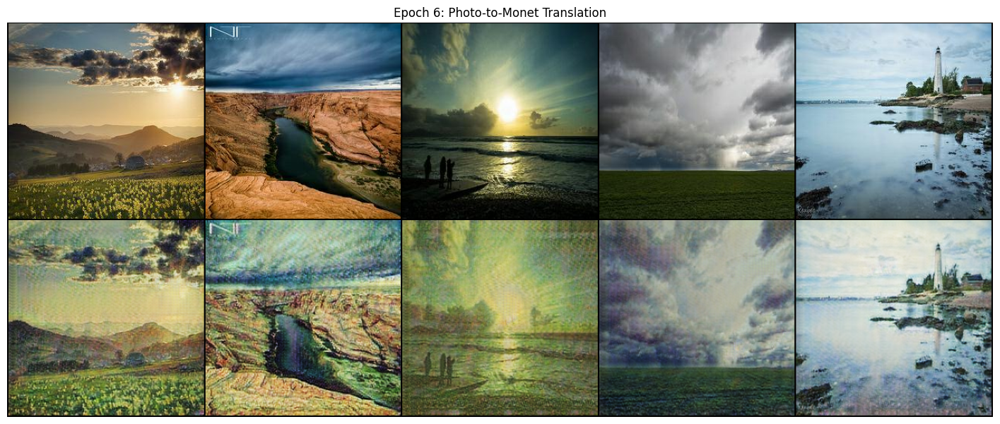

Epoch 6 - lr: 0.00020 - gen_loss: 5.23438 - disc_loss_M: 0.15370 - disc_loss_P: 0.15891
Epoch 7 - lr: 0.00020 - gen_loss: 5.13606 - disc_loss_M: 0.15436 - disc_loss_P: 0.15539
Epoch 8 - lr: 0.00020 - gen_loss: 5.04418 - disc_loss_M: 0.15320 - disc_loss_P: 0.15569
Epoch 9 - lr: 0.00020 - gen_loss: 4.97983 - disc_loss_M: 0.15282 - disc_loss_P: 0.15528
Epoch 10 - lr: 0.00020 - gen_loss: 4.91423 - disc_loss_M: 0.15005 - disc_loss_P: 0.15382
Epoch 11 - lr: 0.00020 - gen_loss: 4.87258 - disc_loss_M: 0.14671 - disc_loss_P: 0.15471


Validation: |          | 0/? [00:00<?, ?it/s]

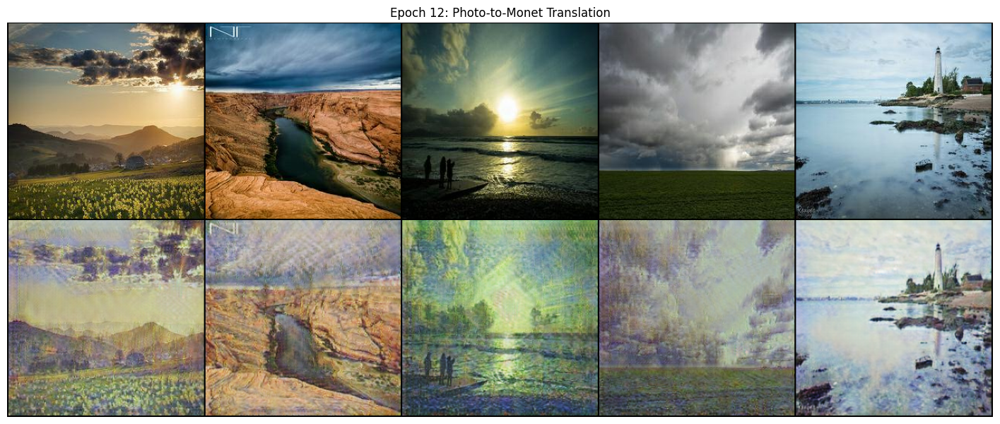

Epoch 12 - lr: 0.00020 - gen_loss: 4.81015 - disc_loss_M: 0.14486 - disc_loss_P: 0.15363
Epoch 13 - lr: 0.00020 - gen_loss: 4.76956 - disc_loss_M: 0.13990 - disc_loss_P: 0.15362
Epoch 14 - lr: 0.00020 - gen_loss: 4.72702 - disc_loss_M: 0.13978 - disc_loss_P: 0.14930
Epoch 15 - lr: 0.00020 - gen_loss: 4.71646 - disc_loss_M: 0.13665 - disc_loss_P: 0.14828
Epoch 16 - lr: 0.00020 - gen_loss: 4.67494 - disc_loss_M: 0.13601 - disc_loss_P: 0.15199
Epoch 17 - lr: 0.00020 - gen_loss: 4.62741 - disc_loss_M: 0.13447 - disc_loss_P: 0.15080


Validation: |          | 0/? [00:00<?, ?it/s]

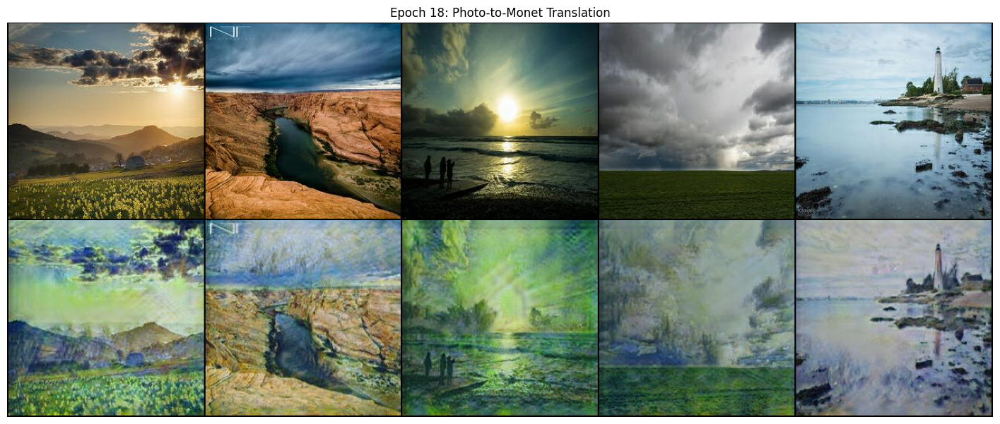

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=18` reached.


Epoch 18 - lr: 0.00020 - gen_loss: 4.61983 - disc_loss_M: 0.13276 - disc_loss_P: 0.15132
Training ended.


In [ ]:
dm = CustomDataModule(**DM_CONFIG)
model = CycleGAN(**MODEL_CONFIG)
trainer = L.Trainer(
    callbacks=[checkpoint_callback],
    **TRAIN_CONFIG
)

trainer.fit(model, datamodule=dm)

## MiFID - Our model - 18 epochs

### Loading checkpoint from google drive

In [ ]:
model = CycleGAN.load_from_checkpoint(
    "/content/gdrive/MyDrive/ColabCheckpoints/checkpoints/monet-epoch=17-gen_loss=4.6274.ckpt",
    gen_name="resnet",
    num_resblocks=6,
    hid_channels=64,
    optimizer=torch.optim.Adam,  # must be added manually
    lr=2e-4,
    betas=(0.5, 0.999),
    lambda_idt=0.5,
    lambda_cycle=(10, 10),
    buffer_size=100,
    num_epochs=18,
    decay_epochs=18
)
model.eval()

CycleGAN(
  (gen_PM): ResNetGenerator(
    (model): Sequential(
      (0): ReflectionPad2d((3, 3, 3, 3))
      (1): Downsampling(
        (block): Sequential(
          (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), bias=False)
          (1): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (2): Downsampling(
        (block): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (3): Downsampling(
        (block): Sequential(
          (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (4): Re

In [ ]:
mifid = MemorizationInformedFrechetInceptionDistance(normalize=True).cuda()

Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:00<00:00, 145MB/s]


### Loading to MiFID Monet images

In [ ]:
# MiFID expects [0,-1] range
target_dim = 256
transform_monet = T.Compose([
    T.Resize((target_dim, target_dim), antialias=True),
    T.ToTensor()
])
target_dim = 256
transform = T.Compose([
    T.Resize((target_dim, target_dim), antialias=True),
    T.ToTensor(),
    T.Normalize((0.5,), (0.5,))  # match CycleGAN training: [-1, 1] range
])

In [ ]:
monet_filenames = sorted(glob.glob(os.path.join("/content/monet_jpg", "*.jpg")))

for fname in monet_filenames:
    img = Image.open(fname).convert("RGB")
    img_tensor = transform_monet(img).unsqueeze(0).cuda()
    mifid.update(img_tensor, real=True)

### Loading to MiFID generated images

In [ ]:
output_path = r"/content/generated_monet_ours/"
os.mkdir(output_path)
photo_filenames = sorted(glob.glob(os.path.join("/content/photo_jpg", "*.jpg")))

for i,fname in enumerate(photo_filenames):
    img = Image.open(fname).convert("RGB")
    img_tensor = transform(img).unsqueeze(0).cuda()

    # Generate Monet-style image using your CycleGAN model
    with torch.no_grad():
        output = model.gen_PM(img_tensor)

    # Ensure output is in [0,1]
    output = (output + 1) / 2
    output = torch.clamp(output, 0, 1)

    save_image(output, f"{output_path}{os.path.basename(fname)}")

    mifid.update(output, real=False)

### Calculate score

In [ ]:
score = mifid.compute()
print("MiFID score:", score.item())

MiFID score: 95.33037567138672


### Save to zip in google drive

In [ ]:
!zip -r /content/generated_monet_ours.zip /content/generated_monet_ours/
!cp /content/generated_monet_ours.zip /content/gdrive/MyDrive/ColabCheckpoints/

Streaming output truncated to the last 5000 lines.
  adding: content/generated_monet_ours/5c50599656.jpg (deflated 2%)
  adding: content/generated_monet_ours/8f59672761.jpg (deflated 1%)
  adding: content/generated_monet_ours/5074e8a51e.jpg (deflated 1%)
  adding: content/generated_monet_ours/64bd39e960.jpg (deflated 1%)
  adding: content/generated_monet_ours/b46106fd89.jpg (deflated 2%)
  adding: content/generated_monet_ours/75979a026b.jpg (deflated 1%)
  adding: content/generated_monet_ours/3f8fd85f1c.jpg (deflated 2%)
  adding: content/generated_monet_ours/efd9e949f5.jpg (deflated 1%)
  adding: content/generated_monet_ours/95b6abfcee.jpg (deflated 1%)
  adding: content/generated_monet_ours/4a2c4db283.jpg (deflated 1%)
  adding: content/generated_monet_ours/c88254adbe.jpg (deflated 1%)
  adding: content/generated_monet_ours/759dcb713c.jpg (deflated 1%)
  adding: content/generated_monet_ours/803cdfa30d.jpg (deflated 1%)
  adding: content/generated_monet_ours/95a6bdb3bf.jpg (deflated 1

## Continue training - 30 epochs

### Training config

In [ ]:
TRAIN_CONFIG = {
    "accelerator": "gpu" if torch.cuda.is_available() else "cpu",

    "precision": "16-mixed" if torch.cuda.is_available() else 32,

    "devices": 1,

    "enable_checkpointing": True,

    "logger": False,

    "max_epochs": 30,
    "limit_train_batches": 1.0,
    "limit_predict_batches": 1.0,

    "max_time": {"hours": 20, "minutes": 0},

    # use a small subset of photos for validation/testing
    "limit_val_batches": 1,
    "limit_test_batches": 5,

    "num_sanity_val_steps": 0,

    # the frequency to visualize the progress of adding Monet style
    "check_val_every_n_epoch": 6,
}

### Loading last checkpoint and continue training

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_val_batches=1)` was configured so 1 batch will be used.
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_predict_batches=1.0)` was configured so 100% of the batches will be used..
INFO:pytorch_lightning.utilities.rank_zero:You are using a CUDA device ('NVIDIA A100-SXM4-40GB') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more detail

Model initialized.


/usr/local/lib/python3.11/dist-packages/pytorch_lightning/callbacks/model_checkpoint.py:366: The dirpath has changed from '/content/gdrive/MyDrive/ColabCheckpoints' to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan', therefore `best_model_score`, `kth_best_model_path`, `kth_value`, `last_model_path` and `best_k_models` won't be reloaded. Only `best_model_path` will be reloaded.
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name   | Type            | Params | Mode 
---------------------------------------------------
0 | gen_PM | ResNetGenerator | 7.9 M  | train
1 | gen_MP | ResNetGenerator | 7.9 M  | train
2 | disc_M | Discriminator   | 2.8 M  | train
3 | disc_P | Discriminator   | 2.8 M  | train
---------------------------------------------------
21.4 M    Trainable params
0         Non-trainable params
21.4 M    Total params
85.431    Total estimated model params size (MB)
314       Modu

Training: |          | 0/? [00:00<?, ?it/s]

Epoch 18
Epoch 19 - lr: 0.00018 - gen_loss: 4.59118 - disc_loss_M: 0.12707 - disc_loss_P: 0.14683
Epoch 20 - lr: 0.00017 - gen_loss: 4.50928 - disc_loss_M: 0.12475 - disc_loss_P: 0.14755
Epoch 21 - lr: 0.00015 - gen_loss: 4.47262 - disc_loss_M: 0.12056 - disc_loss_P: 0.14559
Epoch 22 - lr: 0.00014 - gen_loss: 4.45429 - disc_loss_M: 0.11663 - disc_loss_P: 0.14447
Epoch 23 - lr: 0.00012 - gen_loss: 4.41156 - disc_loss_M: 0.11184 - disc_loss_P: 0.14269


Validation: |          | 0/? [00:00<?, ?it/s]

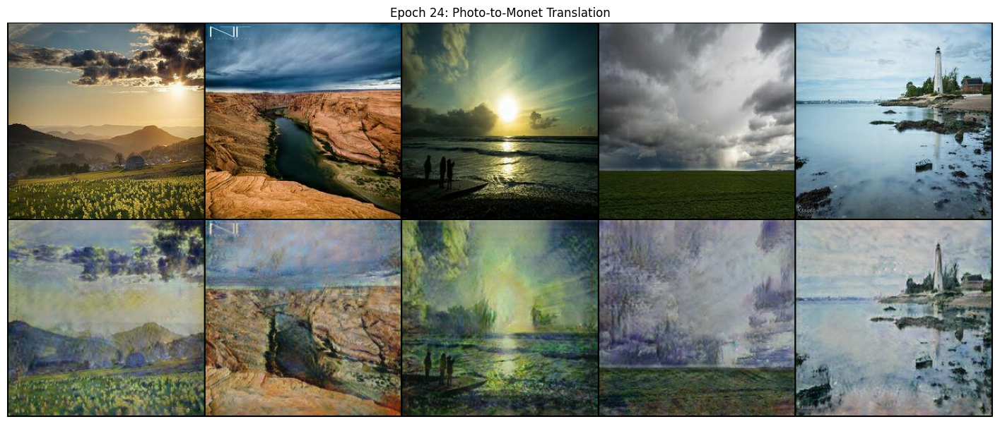

INFO:pytorch_lightning.utilities.rank_zero:Epoch 23, global step 337824: 'gen_loss' reached 4.41156 (best 4.41156), saving model to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/monet-epoch=23-gen_loss=4.4116.ckpt' as top 3


Epoch 24 - lr: 0.00011 - gen_loss: 4.40142 - disc_loss_M: 0.10803 - disc_loss_P: 0.14108
Epoch 25 - lr: 0.00009 - gen_loss: 4.36508 - disc_loss_M: 0.10425 - disc_loss_P: 0.13924
Epoch 26 - lr: 0.00008 - gen_loss: 4.33058 - disc_loss_M: 0.10000 - disc_loss_P: 0.13883
Epoch 27 - lr: 0.00006 - gen_loss: 4.30590 - disc_loss_M: 0.09589 - disc_loss_P: 0.13834
Epoch 28 - lr: 0.00005 - gen_loss: 4.30542 - disc_loss_M: 0.09220 - disc_loss_P: 0.13596
Epoch 29 - lr: 0.00003 - gen_loss: 4.31121 - disc_loss_M: 0.09022 - disc_loss_P: 0.13513


Validation: |          | 0/? [00:00<?, ?it/s]

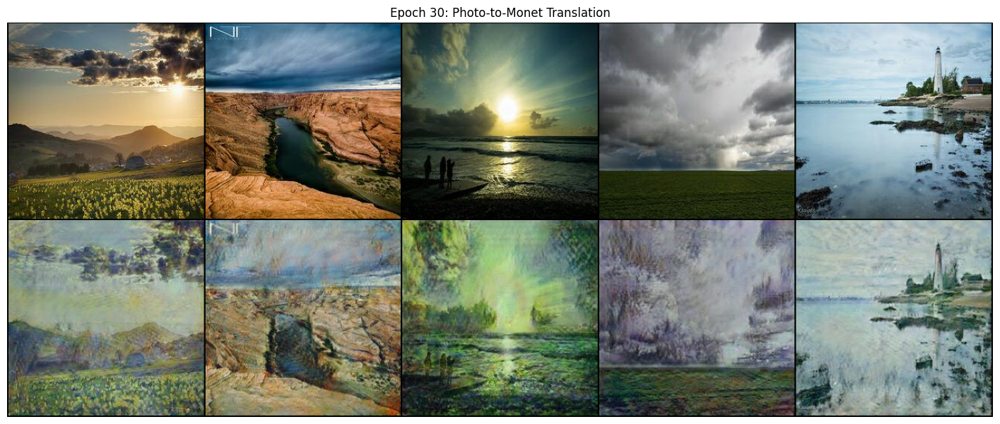

INFO:pytorch_lightning.utilities.rank_zero:Epoch 29, global step 422280: 'gen_loss' reached 4.31121 (best 4.31121), saving model to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/monet-epoch=29-gen_loss=4.3112.ckpt' as top 3
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=30` reached.


Epoch 30 - lr: 0.00002 - gen_loss: 4.27121 - disc_loss_M: 0.08617 - disc_loss_P: 0.13291
Training ended.


In [ ]:
checkpoint_path = "/content/gdrive/MyDrive/ColabCheckpoints/checkpoints/monet-epoch=17-gen_loss=4.6274.ckpt"

MODEL_CONFIG["num_epochs"] = 30

dm = CustomDataModule(**DM_CONFIG)
model = CycleGAN(**MODEL_CONFIG)
trainer = L.Trainer(
    callbacks=[checkpoint_callback],
    **TRAIN_CONFIG
)

trainer.fit(model, datamodule=dm, ckpt_path=checkpoint_path)

## MiFID - Our model - 30 epochs

### Loading checkpoint from google drive

In [ ]:
model = CycleGAN.load_from_checkpoint(
    "/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/last.ckpt",
    gen_name="resnet",
    num_resblocks=6,
    hid_channels=64,
    optimizer=torch.optim.Adam,
    lr=2e-4,
    betas=(0.5, 0.999),
    lambda_idt=0.5,
    lambda_cycle=(10, 10),
    buffer_size=100,
    num_epochs=18,
    decay_epochs=18
)
model.eval()

CycleGAN(
  (gen_PM): ResNetGenerator(
    (model): Sequential(
      (0): ReflectionPad2d((3, 3, 3, 3))
      (1): Downsampling(
        (block): Sequential(
          (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), bias=False)
          (1): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (2): Downsampling(
        (block): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (3): Downsampling(
        (block): Sequential(
          (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (4): Re

In [ ]:
mifid = MemorizationInformedFrechetInceptionDistance(normalize=True).cuda()

Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:00<00:00, 250MB/s]


### Loading to MiFID Monet images

In [ ]:
# MiFID expects [0,-1] range
target_dim = 256
transform_monet = T.Compose([
    T.Resize((target_dim, target_dim), antialias=True),
    T.ToTensor()
])
target_dim = 256
transform = T.Compose([
    T.Resize((target_dim, target_dim), antialias=True),
    T.ToTensor(),
    T.Normalize((0.5,), (0.5,))  # match CycleGAN training: [-1, 1] range
])

In [ ]:
monet_filenames = sorted(glob.glob(os.path.join("/content/monet_jpg", "*.jpg")))

for fname in monet_filenames:
    img = Image.open(fname).convert("RGB")
    img_tensor = transform_monet(img).unsqueeze(0).cuda()
    mifid.update(img_tensor, real=True)

### Loading to MiFID generated images

In [ ]:
output_path = r"/content/generated_monet_ours_30/"
os.mkdir(output_path)
photo_filenames = sorted(glob.glob(os.path.join("/content/photo_jpg", "*.jpg")))

for i,fname in enumerate(photo_filenames):
    img = Image.open(fname).convert("RGB")
    img_tensor = transform(img).unsqueeze(0).cuda()

    # Generate Monet-style image using your CycleGAN model
    with torch.no_grad():
        output = model.gen_PM(img_tensor)

    # Ensure output is in [0,1]
    output = (output + 1) / 2
    output = torch.clamp(output, 0, 1)

    save_image(output, f"{output_path}{os.path.basename(fname)}")

    mifid.update(output, real=False)

### Calculate score

In [ ]:
score = mifid.compute()
print("MiFID score:", score.item())

MiFID score: 89.12020111083984


## Continue training - 50 epochs

### Training config

In [ ]:
TRAIN_CONFIG = {
    "accelerator": "gpu" if torch.cuda.is_available() else "cpu",

    "precision": "16-mixed" if torch.cuda.is_available() else 32,

    "devices": 1,

    "enable_checkpointing": True,

    "logger": False,

    "max_epochs": 50,
    "limit_train_batches": 1.0,
    "limit_predict_batches": 1.0,

    "max_time": {"hours": 100, "minutes": 0},

    # use a small subset of photos for validation/testing
    "limit_val_batches": 1,
    "limit_test_batches": 5,

    "num_sanity_val_steps": 0,

    # the frequency to visualize the progress of adding Monet style
    "check_val_every_n_epoch": 6,
}

### Loading last checkpoint and continue training

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_val_batches=1)` was configured so 1 batch will be used.
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_predict_batches=1.0)` was configured so 100% of the batches will be used..
INFO:pytorch_lightning.utilities.rank_zero:Restoring states from the checkpoint path at /content/gdrive/MyDrive/ColabCheckpoints/checkpoints/monet-epoch=29-gen_loss=4.3112.ckpt


Model initialized.


INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name   | Type            | Params | Mode 
---------------------------------------------------
0 | gen_PM | ResNetGenerator | 7.9 M  | train
1 | gen_MP | ResNetGenerator | 7.9 M  | train
2 | disc_M | Discriminator   | 2.8 M  | train
3 | disc_P | Discriminator   | 2.8 M  | train
---------------------------------------------------
21.4 M    Trainable params
0         Non-trainable params
21.4 M    Total params
85.431    Total estimated model params size (MB)
314       Modules in train mode
0         Modules in eval mode
INFO:pytorch_lightning.utilities.rank_zero:Restored all states from the checkpoint at /content/gdrive/MyDrive/ColabCheckpoints/checkpoints/monet-epoch=29-gen_loss=4.3112.ckpt


Training: |          | 0/? [00:00<?, ?it/s]

Epoch 30
Epoch 31 - lr: 0.00012 - gen_loss: 4.40131 - disc_loss_M: 0.10958 - disc_loss_P: 0.14930
Epoch 32 - lr: 0.00012 - gen_loss: 4.36704 - disc_loss_M: 0.10484 - disc_loss_P: 0.14611
Epoch 33 - lr: 0.00011 - gen_loss: 4.30770 - disc_loss_M: 0.10079 - disc_loss_P: 0.14569
Epoch 34 - lr: 0.00010 - gen_loss: 4.28603 - disc_loss_M: 0.09841 - disc_loss_P: 0.14354
Epoch 35 - lr: 0.00010 - gen_loss: 4.28883 - disc_loss_M: 0.09641 - disc_loss_P: 0.14481


Validation: |          | 0/? [00:00<?, ?it/s]

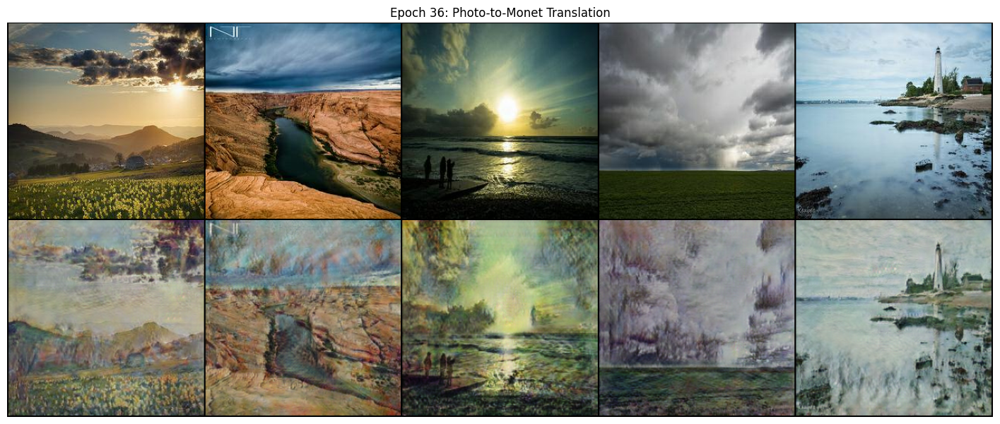

INFO:pytorch_lightning.utilities.rank_zero:Epoch 35, global step 506736: 'gen_loss' reached 4.28883 (best 4.28883), saving model to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/monet-epoch=35-gen_loss=4.2888.ckpt' as top 3


Epoch 36 - lr: 0.00009 - gen_loss: 4.25037 - disc_loss_M: 0.09389 - disc_loss_P: 0.14564
Epoch 37 - lr: 0.00008 - gen_loss: 4.22829 - disc_loss_M: 0.09195 - disc_loss_P: 0.14664
Epoch 38 - lr: 0.00008 - gen_loss: 4.23235 - disc_loss_M: 0.08805 - disc_loss_P: 0.14450
Epoch 39 - lr: 0.00007 - gen_loss: 4.23488 - disc_loss_M: 0.08621 - disc_loss_P: 0.14224
Epoch 40 - lr: 0.00007 - gen_loss: 4.22814 - disc_loss_M: 0.08338 - disc_loss_P: 0.14026
Epoch 41 - lr: 0.00006 - gen_loss: 4.24066 - disc_loss_M: 0.08096 - disc_loss_P: 0.14112


Validation: |          | 0/? [00:00<?, ?it/s]

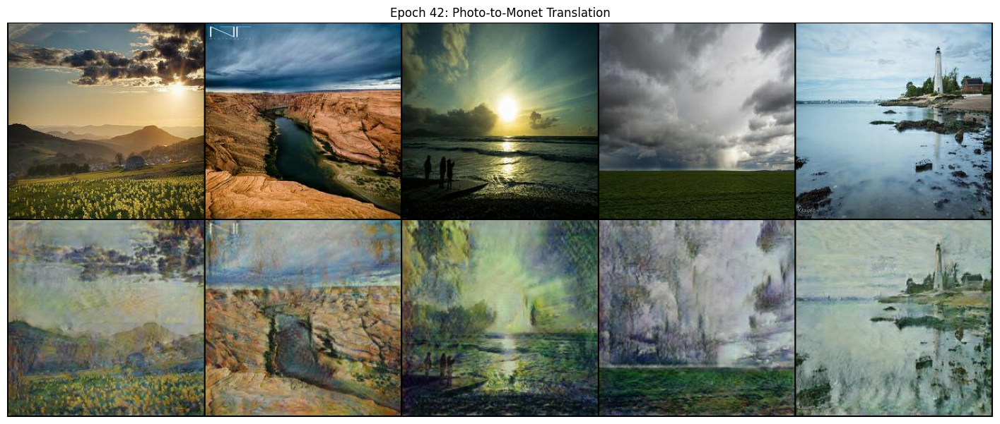

INFO:pytorch_lightning.utilities.rank_zero:Epoch 41, global step 591192: 'gen_loss' reached 4.24066 (best 4.24066), saving model to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/monet-epoch=41-gen_loss=4.2407.ckpt' as top 3


Epoch 42 - lr: 0.00005 - gen_loss: 4.22091 - disc_loss_M: 0.07883 - disc_loss_P: 0.14214
Epoch 43 - lr: 0.00005 - gen_loss: 4.20672 - disc_loss_M: 0.07776 - disc_loss_P: 0.14112
Epoch 44 - lr: 0.00004 - gen_loss: 4.21022 - disc_loss_M: 0.07450 - disc_loss_P: 0.14063
Epoch 45 - lr: 0.00004 - gen_loss: 4.20686 - disc_loss_M: 0.07207 - disc_loss_P: 0.13919
Epoch 46 - lr: 0.00003 - gen_loss: 4.18731 - disc_loss_M: 0.07134 - disc_loss_P: 0.14131
Epoch 47 - lr: 0.00002 - gen_loss: 4.16757 - disc_loss_M: 0.06928 - disc_loss_P: 0.14204


Validation: |          | 0/? [00:00<?, ?it/s]

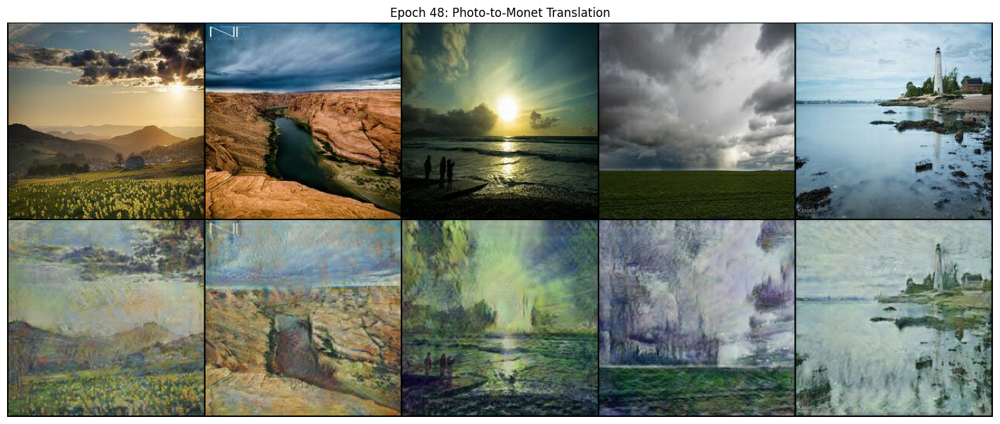

INFO:pytorch_lightning.utilities.rank_zero:Epoch 47, global step 675648: 'gen_loss' reached 4.16757 (best 4.16757), saving model to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/monet-epoch=47-gen_loss=4.1676.ckpt' as top 3


Epoch 48 - lr: 0.00002 - gen_loss: 4.17100 - disc_loss_M: 0.06762 - disc_loss_P: 0.14021
Epoch 49 - lr: 0.00001 - gen_loss: 4.17316 - disc_loss_M: 0.06655 - disc_loss_P: 0.14038


INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=50` reached.


Epoch 50 - lr: 0.00001 - gen_loss: 4.16752 - disc_loss_M: 0.06510 - disc_loss_P: 0.13893
Training ended.


In [ ]:
checkpoint_path = "/content/gdrive/MyDrive/ColabCheckpoints/checkpoints/monet-epoch=29-gen_loss=4.3112.ckpt"

MODEL_CONFIG["num_epochs"] = 50

dm = CustomDataModule(**DM_CONFIG)
model = CycleGAN(**MODEL_CONFIG)
trainer = L.Trainer(
    callbacks=[checkpoint_callback],
    **TRAIN_CONFIG
)

trainer.fit(model, datamodule=dm, ckpt_path=checkpoint_path)

## MiFID - Our model - 50 epochs

### Loading checkpoint from google drive

In [ ]:
model = CycleGAN.load_from_checkpoint(
    "/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/last.ckpt",
    gen_name="resnet",
    num_resblocks=6,
    hid_channels=64,
    optimizer=torch.optim.Adam,
    lr=2e-4,
    betas=(0.5, 0.999),
    lambda_idt=0.5,
    lambda_cycle=(10, 10),
    buffer_size=100,
    num_epochs=18,
    decay_epochs=18
)
model.eval()

CycleGAN(
  (gen_PM): ResNetGenerator(
    (model): Sequential(
      (0): ReflectionPad2d((3, 3, 3, 3))
      (1): Downsampling(
        (block): Sequential(
          (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), bias=False)
          (1): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (2): Downsampling(
        (block): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (3): Downsampling(
        (block): Sequential(
          (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (4): Re

In [ ]:
mifid = MemorizationInformedFrechetInceptionDistance(normalize=True).cuda()

### Loading to MiFID Monet images

In [ ]:
# MiFID expects [0,-1] range
target_dim = 256
transform_monet = T.Compose([
    T.Resize((target_dim, target_dim), antialias=True),
    T.ToTensor()
])
target_dim = 256
transform = T.Compose([
    T.Resize((target_dim, target_dim), antialias=True),
    T.ToTensor(),
    T.Normalize((0.5,), (0.5,))  # match CycleGAN training: [-1, 1] range
])

In [ ]:
monet_filenames = sorted(glob.glob(os.path.join("/content/monet_jpg", "*.jpg")))

for fname in monet_filenames:
    img = Image.open(fname).convert("RGB")
    img_tensor = transform_monet(img).unsqueeze(0).cuda()
    mifid.update(img_tensor, real=True)

### Loading to MiFID generated images

In [ ]:
output_path = r"/content/generated_monet_ours_50/"
os.mkdir(output_path)
photo_filenames = sorted(glob.glob(os.path.join("/content/photo_jpg", "*.jpg")))

for i,fname in enumerate(photo_filenames):
    img = Image.open(fname).convert("RGB")
    img_tensor = transform(img).unsqueeze(0).cuda()

    # Generate Monet-style image using your CycleGAN model
    with torch.no_grad():
        output = model.gen_PM(img_tensor)

    # Ensure output is in [0,1]
    output = (output + 1) / 2
    output = torch.clamp(output, 0, 1)

    save_image(output, f"{output_path}{os.path.basename(fname)}")

    mifid.update(output, real=False)

### Calculate score

In [ ]:
score = mifid.compute()
print("MiFID score:", score.item())

MiFID score: 83.95442962646484


### Save to zip in google drive

In [ ]:
!zip -r /content/generated_monet_50.zip /content/generated_monet_ours_50/
!cp /content/generated_monet_50.zip /content/gdrive/MyDrive/ColabCheckpoints/

Streaming output truncated to the last 5000 lines.
  adding: content/generated_monet_50/a1a84d3eda.jpg (deflated 1%)
  adding: content/generated_monet_50/ab4450580b.jpg (deflated 2%)
  adding: content/generated_monet_50/8b8987492f.jpg (deflated 1%)
  adding: content/generated_monet_50/306ebd4b5c.jpg (deflated 1%)
  adding: content/generated_monet_50/cfc6d4340f.jpg (deflated 1%)
  adding: content/generated_monet_50/9ccca8eac7.jpg (deflated 1%)
  adding: content/generated_monet_50/6127261426.jpg (deflated 1%)
  adding: content/generated_monet_50/516670d194.jpg (deflated 1%)
  adding: content/generated_monet_50/209873c58f.jpg (deflated 1%)
  adding: content/generated_monet_50/2fa51ca1fa.jpg (deflated 1%)
  adding: content/generated_monet_50/334259faa0.jpg (deflated 2%)
  adding: content/generated_monet_50/8a01bb88d9.jpg (deflated 1%)
  adding: content/generated_monet_50/23fb1a1690.jpg (deflated 1%)
  adding: content/generated_monet_50/2cf96e5d1d.jpg (deflated 1%)
  adding: content/generat

# Ablation study

## ResNet

### ResNet only generator

In [ ]:
class ResNetGenerator(nn.Module):
    def __init__(self, hid_channels, in_channels, out_channels, num_resblocks):
        super().__init__()
        self.model = nn.Sequential(
            nn.ReflectionPad2d(3),
            Downsampling(in_channels, hid_channels,
                         kernel_size=7, stride=1, padding=0, lrelu=False),
            Downsampling(hid_channels, hid_channels*2, kernel_size=3, lrelu=False),
            Downsampling(hid_channels*2, hid_channels*4, kernel_size=3, lrelu=False),

            # only ResBlocks blocks
            *[ResBlock(hid_channels*4) for _ in range(num_resblocks)],

            Upsampling(hid_channels*4, hid_channels*2, kernel_size=3, output_padding=1),
            Upsampling(hid_channels*2, hid_channels, kernel_size=3, output_padding=1),
            nn.ReflectionPad2d(3),
            nn.Conv2d(hid_channels, out_channels, kernel_size=7, stride=1, padding=0),
            nn.Tanh(),
        )

    def forward(self, x):
        return self.model(x)


In [ ]:
def get_gen(gen_name, hid_channels, num_resblocks, in_channels=3, out_channels=3):
    if gen_name == "resnet":
        return ResNetGenerator(hid_channels, in_channels, out_channels, num_resblocks)
    else:
        raise NotImplementedError(f"Generator name '{gen_name}' not recognized.")

### CycleGAN ResNet based

#### CycleGAN model config

In [ ]:
MODEL_CONFIG = {

    "gen_name": "resnet",
    "num_resblocks": 6,


    "hid_channels": 64,


    "optimizer": torch.optim.Adam,

    # the learning rate and beta parameters for the Adam optimizer
    "lr": 2e-4,
    "betas": (0.5, 0.999),

    # the weights used in the identity loss and cycle loss
    "lambda_idt": 0.5,
    "lambda_cycle": (10, 10), # (MPM direction, PMP direction)

    # the size of the buffer that stores previously generated images
    "buffer_size": 100,

    "num_epochs": 18,

    # the number of epochs before starting the learning rate decay
    "decay_epochs": 18,
}

#### CycleGAN module

In [ ]:
class CycleGAN(L.LightningModule):
    def __init__(
        self,
        gen_name,
        num_resblocks,
        hid_channels,
        optimizer,
        lr,
        betas,
        lambda_idt,
        lambda_cycle,
        buffer_size,
        num_epochs,
        decay_epochs,
    ):
        super().__init__()
        self.save_hyperparameters(ignore=["optimizer"])
        self.optimizer = optimizer
        self.automatic_optimization = False

        self.gen_PM = get_gen(gen_name, hid_channels, num_resblocks)
        self.gen_MP = get_gen(gen_name, hid_channels, num_resblocks)
        self.disc_M = Discriminator(hid_channels)
        self.disc_P = Discriminator(hid_channels)

        # initialize buffers to store fake images
        self.buffer_fake_M = ImageBuffer(buffer_size)
        self.buffer_fake_P = ImageBuffer(buffer_size)

    def forward(self, img):
        return self.gen_PM(img)

    def init_weights(self):
        def init_fn(m):
            if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.InstanceNorm2d)):
                nn.init.normal_(m.weight, 0.0, 0.02)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0.0)

        for net in [self.gen_PM, self.gen_MP, self.disc_M, self.disc_P]:
            net.apply(init_fn)

    def setup(self, stage):
        if stage == "fit":
            self.init_weights()
            print("Model initialized.")

    def get_lr_scheduler(self, optimizer):
        def lr_lambda(epoch):
            len_decay_phase = self.hparams.num_epochs - self.hparams.decay_epochs + 1.0
            curr_decay_step = max(0, epoch - self.hparams.decay_epochs + 1.0)
            val = 1.0 - curr_decay_step / len_decay_phase
            return max(0.0, val)

        return torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lr_lambda)

    def configure_optimizers(self):
        opt_config = {
            "lr": self.hparams.lr,
            "betas": self.hparams.betas,
        }
        opt_gen = self.optimizer(
            list(self.gen_PM.parameters()) + list(self.gen_MP.parameters()),
            **opt_config,
        )
        opt_disc = self.optimizer(
            list(self.disc_M.parameters()) + list(self.disc_P.parameters()),
            **opt_config,
        )
        optimizers = [opt_gen, opt_disc]
        schedulers = [self.get_lr_scheduler(opt) for opt in optimizers]
        return optimizers, schedulers

    def adv_criterion(self, y_hat, y):
        return F.mse_loss(y_hat, y)

    def recon_criterion(self, y_hat, y):
        return F.l1_loss(y_hat, y)

    def get_adv_loss(self, fake, disc):
        fake_hat = disc(fake)
        real_labels = torch.ones_like(fake_hat)
        adv_loss = self.adv_criterion(fake_hat, real_labels)
        return adv_loss

    def get_idt_loss(self, real, idt, lambda_cycle):
        idt_loss = self.recon_criterion(idt, real)
        return self.hparams.lambda_idt * lambda_cycle * idt_loss

    def get_cycle_loss(self, real, recon, lambda_cycle):
        cycle_loss = self.recon_criterion(recon, real)
        return lambda_cycle * cycle_loss

    def get_gen_loss(self):
        # calculate adversarial loss
        adv_loss_PM = self.get_adv_loss(self.fake_M, self.disc_M)
        adv_loss_MP = self.get_adv_loss(self.fake_P, self.disc_P)
        total_adv_loss = adv_loss_PM + adv_loss_MP

        # calculate identity loss
        lambda_cycle = self.hparams.lambda_cycle
        idt_loss_MM = self.get_idt_loss(self.real_M, self.idt_M, lambda_cycle[0])
        idt_loss_PP = self.get_idt_loss(self.real_P, self.idt_P, lambda_cycle[1])
        total_idt_loss = idt_loss_MM + idt_loss_PP

        # calculate cycle loss
        cycle_loss_MPM = self.get_cycle_loss(self.real_M, self.recon_M, lambda_cycle[0])
        cycle_loss_PMP = self.get_cycle_loss(self.real_P, self.recon_P, lambda_cycle[1])
        total_cycle_loss = cycle_loss_MPM + cycle_loss_PMP

        # combine losses
        gen_loss = total_adv_loss + total_idt_loss + total_cycle_loss
        return gen_loss

    def get_disc_loss(self, real, fake, disc):
        # calculate loss on real images
        real_hat = disc(real)
        real_labels = torch.ones_like(real_hat)
        real_loss = self.adv_criterion(real_hat, real_labels)

        # calculate loss on fake images
        fake_hat = disc(fake.detach())
        fake_labels = torch.zeros_like(fake_hat)
        fake_loss = self.adv_criterion(fake_hat, fake_labels)

        # combine losses
        disc_loss = (fake_loss + real_loss) * 0.5
        return disc_loss

    def get_disc_loss_M(self):
        fake_M = self.buffer_fake_M(self.fake_M)
        return self.get_disc_loss(self.real_M, fake_M, self.disc_M)

    def get_disc_loss_P(self):
        fake_P = self.buffer_fake_P(self.fake_P)
        return self.get_disc_loss(self.real_P, fake_P, self.disc_P)

    def training_step(self, batch, batch_idx):
        self.real_M = batch["monet"]
        self.real_P = batch["photo"]
        opt_gen, opt_disc = self.optimizers()

        self.fake_M = self.gen_PM(self.real_P)
        self.fake_P = self.gen_MP(self.real_M)

        self.idt_M = self.gen_PM(self.real_M)
        self.idt_P = self.gen_MP(self.real_P)

        self.recon_M = self.gen_PM(self.fake_P)
        self.recon_P = self.gen_MP(self.fake_M)

        self.toggle_optimizer(opt_gen)
        gen_loss = self.get_gen_loss()
        opt_gen.zero_grad()
        self.manual_backward(gen_loss)
        opt_gen.step()
        self.untoggle_optimizer(opt_gen)

        self.toggle_optimizer(opt_disc)
        disc_loss_M = self.get_disc_loss_M()
        disc_loss_P = self.get_disc_loss_P()
        opt_disc.zero_grad()
        self.manual_backward(disc_loss_M)
        self.manual_backward(disc_loss_P)
        opt_disc.step()
        self.untoggle_optimizer(opt_disc)

        metrics = {
            "gen_loss": gen_loss,
            "disc_loss_M": disc_loss_M,
            "disc_loss_P": disc_loss_P,
        }
        self.log_dict(metrics, on_step=False, on_epoch=True, prog_bar=True)

    def validation_step(self, batch, batch_idx):
        self.display_results(batch, batch_idx, "validate")

    def test_step(self, batch, batch_idx):
        self.display_results(batch, batch_idx, "test")

    def predict_step(self, batch, batch_idx):
        return self(batch)

    def display_results(self, batch, batch_idx, stage):
        real_P = batch
        fake_M = self(real_P)

        if stage == "validate":
            title = f"Epoch {self.current_epoch+1}: Photo-to-Monet Translation"
        else:
            title = f"Sample {batch_idx+1}: Photo-to-Monet Translation"

        show_img(
            torch.cat([real_P, fake_M], dim=0),
            nrow=len(real_P),
            title=title,
        )

    def on_train_epoch_start(self):
        curr_lr = self.lr_schedulers()[0].get_last_lr()[0]
        self.log("lr", curr_lr, on_step=False, on_epoch=True, prog_bar=True)

    def on_train_epoch_end(self):
        for sch in self.lr_schedulers():
            sch.step()

        logged_values = self.trainer.progress_bar_metrics
        print(
            f"Epoch {self.current_epoch+1}",
            *[f"{k}: {v:.5f}" for k, v in logged_values.items()],
            sep=" - ",
        )

    def on_train_end(self):
        print("Training ended.")

    def on_predict_epoch_end(self):
        predictions = self.trainer.predict_loop.predictions
        num_batches = len(predictions)
        batch_size = predictions[0].shape[0]
        last_batch_diff = batch_size - predictions[-1].shape[0]
        print(f"Number of images generated: {num_batches*batch_size-last_batch_diff}.")

### Training

#### Training config

In [ ]:
TRAIN_CONFIG = {
    "accelerator": "gpu" if torch.cuda.is_available() else "cpu",

    "precision": "16-mixed" if torch.cuda.is_available() else 32,

    "devices": 1,

    "enable_checkpointing": True,

    "logger": False,

    "max_epochs": 18,
    "limit_train_batches": 1.0,
    "limit_predict_batches": 1.0,

    "max_time": {"hours": 10, "minutes": 0},

    # use a small subset of photos for validation/testing (we limit here for flexibility)
    "limit_val_batches": 1,
    "limit_test_batches": 5,

    "num_sanity_val_steps": 0,

    # the frequency to visualize the progress of adding Monet style
    "check_val_every_n_epoch": 6,
}

#### Saving top 3 checkpoints to google drive

In [ ]:
checkpoint_callback = ModelCheckpoint(
    dirpath="/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/",
    filename="ResNet_monet-{epoch:02d}-{gen_loss:.4f}",
    monitor="gen_loss",
    mode="min",
    save_top_k=3,
    save_last=True,
    verbose=True,
)

#### Train

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_val_batches=1)` was configured so 1 batch will be used.
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_predict_batches=1.0)` was configured so 100% of the batches will be used..
INFO:pytorch_lightning.utilities.rank_zero:You are using a CUDA device ('NVIDIA A100-SXM4-40GB') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more detail

Model initialized.


Training: |          | 0/? [00:00<?, ?it/s]

Epoch 1 - lr: 0.00020 - gen_loss: 7.71956 - disc_loss_M: 0.14622 - disc_loss_P: 0.15228
Epoch 2 - lr: 0.00020 - gen_loss: 6.33959 - disc_loss_M: 0.16160 - disc_loss_P: 0.15640
Epoch 3 - lr: 0.00020 - gen_loss: 5.83241 - disc_loss_M: 0.16376 - disc_loss_P: 0.16329
Epoch 4 - lr: 0.00020 - gen_loss: 5.53988 - disc_loss_M: 0.16517 - disc_loss_P: 0.16502
Epoch 5 - lr: 0.00020 - gen_loss: 5.37194 - disc_loss_M: 0.16193 - disc_loss_P: 0.16111


/usr/local/lib/python3.11/dist-packages/pytorch_lightning/trainer/connectors/data_connector.py:425: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Validation: |          | 0/? [00:00<?, ?it/s]

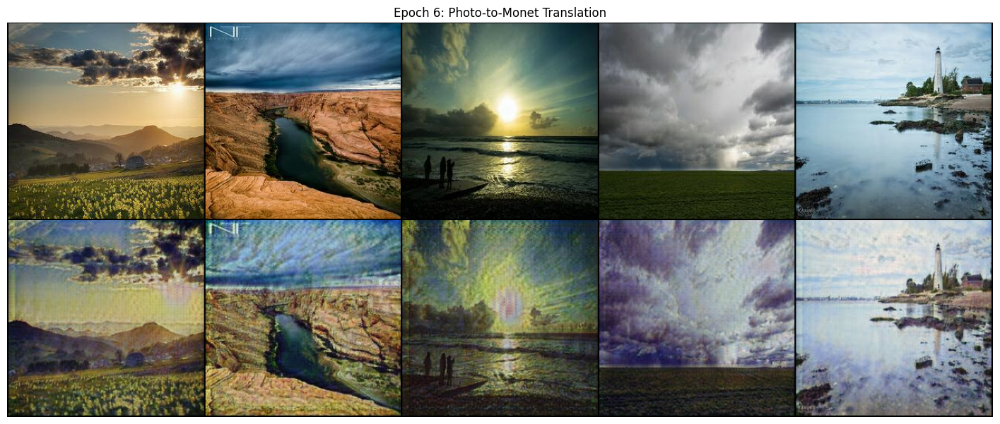

INFO:pytorch_lightning.utilities.rank_zero:Epoch 5, global step 84456: 'gen_loss' reached 5.37194 (best 5.37194), saving model to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/ResNet_monet-epoch=05-gen_loss=5.3719.ckpt' as top 3


Epoch 6 - lr: 0.00020 - gen_loss: 5.24802 - disc_loss_M: 0.16103 - disc_loss_P: 0.15680
Epoch 7 - lr: 0.00020 - gen_loss: 5.11801 - disc_loss_M: 0.15991 - disc_loss_P: 0.15703
Epoch 8 - lr: 0.00020 - gen_loss: 5.03440 - disc_loss_M: 0.15638 - disc_loss_P: 0.15508
Epoch 9 - lr: 0.00020 - gen_loss: 5.00543 - disc_loss_M: 0.15229 - disc_loss_P: 0.15456
Epoch 10 - lr: 0.00020 - gen_loss: 4.95358 - disc_loss_M: 0.14658 - disc_loss_P: 0.15297
Epoch 11 - lr: 0.00020 - gen_loss: 4.87063 - disc_loss_M: 0.14425 - disc_loss_P: 0.15237


Validation: |          | 0/? [00:00<?, ?it/s]

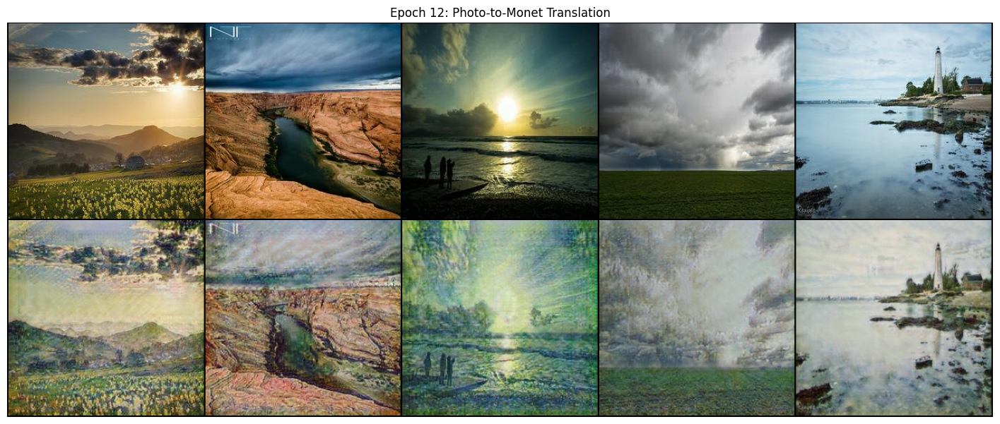

INFO:pytorch_lightning.utilities.rank_zero:Epoch 11, global step 168912: 'gen_loss' reached 4.87063 (best 4.87063), saving model to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/ResNet_monet-epoch=11-gen_loss=4.8706.ckpt' as top 3


Epoch 12 - lr: 0.00020 - gen_loss: 4.85149 - disc_loss_M: 0.14484 - disc_loss_P: 0.15152
Epoch 13 - lr: 0.00020 - gen_loss: 4.77410 - disc_loss_M: 0.14690 - disc_loss_P: 0.15050
Epoch 14 - lr: 0.00020 - gen_loss: 4.74181 - disc_loss_M: 0.14490 - disc_loss_P: 0.15352
Epoch 15 - lr: 0.00020 - gen_loss: 4.68136 - disc_loss_M: 0.14569 - disc_loss_P: 0.15342
Epoch 16 - lr: 0.00020 - gen_loss: 4.64461 - disc_loss_M: 0.14340 - disc_loss_P: 0.15319
Epoch 17 - lr: 0.00020 - gen_loss: 4.62827 - disc_loss_M: 0.13871 - disc_loss_P: 0.15343


Validation: |          | 0/? [00:00<?, ?it/s]

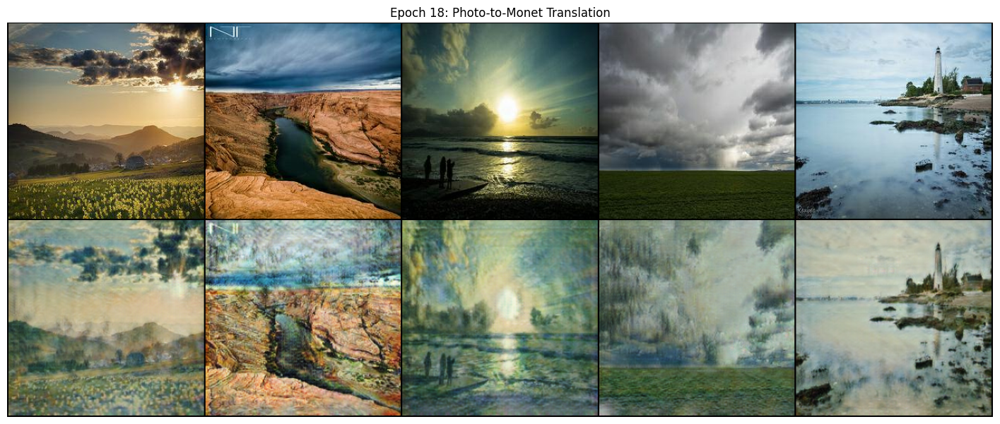

INFO:pytorch_lightning.utilities.rank_zero:Epoch 17, global step 253368: 'gen_loss' reached 4.62827 (best 4.62827), saving model to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/ResNet_monet-epoch=17-gen_loss=4.6283.ckpt' as top 3
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=18` reached.


Epoch 18 - lr: 0.00020 - gen_loss: 4.58265 - disc_loss_M: 0.13749 - disc_loss_P: 0.15206
Training ended.


In [ ]:
dm = CustomDataModule(**DM_CONFIG)
model = CycleGAN(**MODEL_CONFIG)
trainer = L.Trainer(
    callbacks=[checkpoint_callback],
    **TRAIN_CONFIG
)

trainer.fit(model, datamodule=dm)

### MiFID - ResNet

#### Loading checkpoint from google drive

In [ ]:
model = CycleGAN.load_from_checkpoint(
    "/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/ResNet_monet-epoch=17-gen_loss=4.6283.ckpt",
    gen_name="resnet",
    num_resblocks=6,
    hid_channels=64,
    optimizer=torch.optim.Adam,
    lr=2e-4,
    betas=(0.5, 0.999),
    lambda_idt=0.5,
    lambda_cycle=(10, 10),
    buffer_size=100,
    num_epochs=18,
    decay_epochs=18
)
model.eval()

CycleGAN(
  (gen_PM): ResNetGenerator(
    (model): Sequential(
      (0): ReflectionPad2d((3, 3, 3, 3))
      (1): Downsampling(
        (block): Sequential(
          (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), bias=False)
          (1): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (2): Downsampling(
        (block): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (3): Downsampling(
        (block): Sequential(
          (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (4): Re

In [ ]:
mifid = MemorizationInformedFrechetInceptionDistance(normalize=True).cuda()

Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:00<00:00, 233MB/s]


#### Loading to MiFID Monet images

In [ ]:
# MiFID expects [0,-1] range
target_dim = 256
transform_monet = T.Compose([
    T.Resize((target_dim, target_dim), antialias=True),
    T.ToTensor()
])
target_dim = 256
transform = T.Compose([
    T.Resize((target_dim, target_dim), antialias=True),
    T.ToTensor(),
    T.Normalize((0.5,), (0.5,))  # match CycleGAN training: [-1, 1] range
])

In [ ]:
monet_filenames = sorted(glob.glob(os.path.join("/content/monet_jpg", "*.jpg")))

for fname in monet_filenames:
    img = Image.open(fname).convert("RGB")
    img_tensor = transform_monet(img).unsqueeze(0).cuda()
    mifid.update(img_tensor, real=True)

#### Loading to MiFID generated images

In [ ]:
output_path = r"/content/generated_monet_ResNet/"
os.mkdir(output_path)
photo_filenames = sorted(glob.glob(os.path.join("/content/photo_jpg", "*.jpg")))

for i,fname in enumerate(photo_filenames):
    img = Image.open(fname).convert("RGB")
    img_tensor = transform(img).unsqueeze(0).cuda()

    # Generate Monet-style image using your CycleGAN model
    with torch.no_grad():
        output = model.gen_PM(img_tensor)

    # Ensure output is in [0,1]
    output = (output + 1) / 2
    output = torch.clamp(output, 0, 1)

    save_image(output, f"{output_path}{os.path.basename(fname)}")

    mifid.update(output, real=False)

#### Calculate score

In [ ]:
score = mifid.compute()
print("MiFID score:", score.item())

MiFID score: 91.98905944824219


#### Save to zip in google drive

In [ ]:
!zip -r /content/generated_monet_ResNet.zip /content/generated_monet_ResNet/
!cp /content/generated_monet_ResNet.zip /content/gdrive/MyDrive/ColabCheckpoints/

Streaming output truncated to the last 5000 lines.
  adding: content/generated_monet_50_ResNet/a1a84d3eda.jpg (deflated 1%)
  adding: content/generated_monet_50_ResNet/ab4450580b.jpg (deflated 1%)
  adding: content/generated_monet_50_ResNet/8b8987492f.jpg (deflated 2%)
  adding: content/generated_monet_50_ResNet/306ebd4b5c.jpg (deflated 1%)
  adding: content/generated_monet_50_ResNet/cfc6d4340f.jpg (deflated 1%)
  adding: content/generated_monet_50_ResNet/9ccca8eac7.jpg (deflated 1%)
  adding: content/generated_monet_50_ResNet/6127261426.jpg (deflated 1%)
  adding: content/generated_monet_50_ResNet/516670d194.jpg (deflated 1%)
  adding: content/generated_monet_50_ResNet/209873c58f.jpg (deflated 1%)
  adding: content/generated_monet_50_ResNet/2fa51ca1fa.jpg (deflated 1%)
  adding: content/generated_monet_50_ResNet/334259faa0.jpg (deflated 2%)
  adding: content/generated_monet_50_ResNet/8a01bb88d9.jpg (deflated 1%)
  adding: content/generated_monet_50_ResNet/23fb1a1690.jpg (deflated 1%)


## ResNet + Full CTDA

### ResNet full CTDA generator


In [ ]:
class ResNetGenerator(nn.Module):
    def __init__(self, hid_channels, in_channels, out_channels, num_resblocks):
        super().__init__()
        self.model = nn.Sequential(
            nn.ReflectionPad2d(3),
            Downsampling(in_channels, hid_channels,
                         kernel_size=7, stride=1, padding=0, lrelu=False),
            Downsampling(hid_channels, hid_channels*2, kernel_size=3, lrelu=False),
            Downsampling(hid_channels*2, hid_channels*4, kernel_size=3, lrelu=False),

            # only ResBlockCTDA blocks
            *[ResBlockCTDA(hid_channels*4) for _ in range(num_resblocks)],

            Upsampling(hid_channels*4, hid_channels*2, kernel_size=3, output_padding=1),
            Upsampling(hid_channels*2, hid_channels, kernel_size=3, output_padding=1),
            nn.ReflectionPad2d(3),
            nn.Conv2d(hid_channels, out_channels, kernel_size=7, stride=1, padding=0),
            nn.Tanh(),
        )

    def forward(self, x):
        return self.model(x)


### CycleGAN ResNet full CTDA based

#### CycleGAN model config

In [ ]:
MODEL_CONFIG = {

    "gen_name": "resnet",
    "num_resblocks": 6,

    "hid_channels": 64,

    "optimizer": torch.optim.Adam,

    # the learning rate and beta parameters for the Adam optimizer
    "lr": 2e-4,
    "betas": (0.5, 0.999),

    # the weights used in the identity loss and cycle loss
    "lambda_idt": 0.5,
    "lambda_cycle": (10, 10), # (MPM direction, PMP direction)

    # the size of the buffer that stores previously generated images
    "buffer_size": 100,

    "num_epochs": 18,

    # the number of epochs before starting the learning rate decay
    "decay_epochs": 18,
}

#### CycleGAN module

In [ ]:
class CycleGAN(L.LightningModule):
    def __init__(
        self,
        gen_name,
        num_resblocks,
        hid_channels,
        optimizer,
        lr,
        betas,
        lambda_idt,
        lambda_cycle,
        buffer_size,
        num_epochs,
        decay_epochs,
    ):
        super().__init__()
        self.save_hyperparameters(ignore=["optimizer"])
        self.optimizer = optimizer
        self.automatic_optimization = False

        self.gen_PM = get_gen(gen_name, hid_channels, num_resblocks)
        self.gen_MP = get_gen(gen_name, hid_channels, num_resblocks)
        self.disc_M = Discriminator(hid_channels)
        self.disc_P = Discriminator(hid_channels)

        # initialize buffers to store fake images
        self.buffer_fake_M = ImageBuffer(buffer_size)
        self.buffer_fake_P = ImageBuffer(buffer_size)

    def forward(self, img):
        return self.gen_PM(img)

    def init_weights(self):
        def init_fn(m):
            if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.InstanceNorm2d)):
                nn.init.normal_(m.weight, 0.0, 0.02)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0.0)

        for net in [self.gen_PM, self.gen_MP, self.disc_M, self.disc_P]:
            net.apply(init_fn)

    def setup(self, stage):
        if stage == "fit":
            self.init_weights()
            print("Model initialized.")

    def get_lr_scheduler(self, optimizer):
        def lr_lambda(epoch):
            len_decay_phase = self.hparams.num_epochs - self.hparams.decay_epochs + 1.0
            curr_decay_step = max(0, epoch - self.hparams.decay_epochs + 1.0)
            val = 1.0 - curr_decay_step / len_decay_phase
            return max(0.0, val)

        return torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda=lr_lambda)

    def configure_optimizers(self):
        opt_config = {
            "lr": self.hparams.lr,
            "betas": self.hparams.betas,
        }
        opt_gen = self.optimizer(
            list(self.gen_PM.parameters()) + list(self.gen_MP.parameters()),
            **opt_config,
        )
        opt_disc = self.optimizer(
            list(self.disc_M.parameters()) + list(self.disc_P.parameters()),
            **opt_config,
        )
        optimizers = [opt_gen, opt_disc]
        schedulers = [self.get_lr_scheduler(opt) for opt in optimizers]
        return optimizers, schedulers

    def adv_criterion(self, y_hat, y):
        return F.mse_loss(y_hat, y)

    def recon_criterion(self, y_hat, y):
        return F.l1_loss(y_hat, y)

    def get_adv_loss(self, fake, disc):
        fake_hat = disc(fake)
        real_labels = torch.ones_like(fake_hat)
        adv_loss = self.adv_criterion(fake_hat, real_labels)
        return adv_loss

    def get_idt_loss(self, real, idt, lambda_cycle):
        idt_loss = self.recon_criterion(idt, real)
        return self.hparams.lambda_idt * lambda_cycle * idt_loss

    def get_cycle_loss(self, real, recon, lambda_cycle):
        cycle_loss = self.recon_criterion(recon, real)
        return lambda_cycle * cycle_loss

    def get_gen_loss(self):
        # calculate adversarial loss
        adv_loss_PM = self.get_adv_loss(self.fake_M, self.disc_M)
        adv_loss_MP = self.get_adv_loss(self.fake_P, self.disc_P)
        total_adv_loss = adv_loss_PM + adv_loss_MP

        # calculate identity loss
        lambda_cycle = self.hparams.lambda_cycle
        idt_loss_MM = self.get_idt_loss(self.real_M, self.idt_M, lambda_cycle[0])
        idt_loss_PP = self.get_idt_loss(self.real_P, self.idt_P, lambda_cycle[1])
        total_idt_loss = idt_loss_MM + idt_loss_PP

        # calculate cycle loss
        cycle_loss_MPM = self.get_cycle_loss(self.real_M, self.recon_M, lambda_cycle[0])
        cycle_loss_PMP = self.get_cycle_loss(self.real_P, self.recon_P, lambda_cycle[1])
        total_cycle_loss = cycle_loss_MPM + cycle_loss_PMP

        # combine losses
        gen_loss = total_adv_loss + total_idt_loss + total_cycle_loss
        return gen_loss

    def get_disc_loss(self, real, fake, disc):
        # calculate loss on real images
        real_hat = disc(real)
        real_labels = torch.ones_like(real_hat)
        real_loss = self.adv_criterion(real_hat, real_labels)

        # calculate loss on fake images
        fake_hat = disc(fake.detach())
        fake_labels = torch.zeros_like(fake_hat)
        fake_loss = self.adv_criterion(fake_hat, fake_labels)

        # combine losses
        disc_loss = (fake_loss + real_loss) * 0.5
        return disc_loss

    def get_disc_loss_M(self):
        fake_M = self.buffer_fake_M(self.fake_M)
        return self.get_disc_loss(self.real_M, fake_M, self.disc_M)

    def get_disc_loss_P(self):
        fake_P = self.buffer_fake_P(self.fake_P)
        return self.get_disc_loss(self.real_P, fake_P, self.disc_P)

    def training_step(self, batch, batch_idx):
        self.real_M = batch["monet"]
        self.real_P = batch["photo"]
        opt_gen, opt_disc = self.optimizers()

        self.fake_M = self.gen_PM(self.real_P)
        self.fake_P = self.gen_MP(self.real_M)

        self.idt_M = self.gen_PM(self.real_M)
        self.idt_P = self.gen_MP(self.real_P)

        self.recon_M = self.gen_PM(self.fake_P)
        self.recon_P = self.gen_MP(self.fake_M)

        self.toggle_optimizer(opt_gen)
        gen_loss = self.get_gen_loss()
        opt_gen.zero_grad()
        self.manual_backward(gen_loss)
        opt_gen.step()
        self.untoggle_optimizer(opt_gen)

        self.toggle_optimizer(opt_disc)
        disc_loss_M = self.get_disc_loss_M()
        disc_loss_P = self.get_disc_loss_P()
        opt_disc.zero_grad()
        self.manual_backward(disc_loss_M)
        self.manual_backward(disc_loss_P)
        opt_disc.step()
        self.untoggle_optimizer(opt_disc)

        metrics = {
            "gen_loss": gen_loss,
            "disc_loss_M": disc_loss_M,
            "disc_loss_P": disc_loss_P,
        }
        self.log_dict(metrics, on_step=False, on_epoch=True, prog_bar=True)

    def validation_step(self, batch, batch_idx):
        self.display_results(batch, batch_idx, "validate")

    def test_step(self, batch, batch_idx):
        self.display_results(batch, batch_idx, "test")

    def predict_step(self, batch, batch_idx):
        return self(batch)

    def display_results(self, batch, batch_idx, stage):
        real_P = batch
        fake_M = self(real_P)

        if stage == "validate":
            title = f"Epoch {self.current_epoch+1}: Photo-to-Monet Translation"
        else:
            title = f"Sample {batch_idx+1}: Photo-to-Monet Translation"

        show_img(
            torch.cat([real_P, fake_M], dim=0),
            nrow=len(real_P),
            title=title,
        )

    def on_train_epoch_start(self):
        curr_lr = self.lr_schedulers()[0].get_last_lr()[0]
        self.log("lr", curr_lr, on_step=False, on_epoch=True, prog_bar=True)

    def on_train_epoch_end(self):
        for sch in self.lr_schedulers():
            sch.step()

        logged_values = self.trainer.progress_bar_metrics
        print(
            f"Epoch {self.current_epoch+1}",
            *[f"{k}: {v:.5f}" for k, v in logged_values.items()],
            sep=" - ",
        )

    def on_train_end(self):
        print("Training ended.")

    def on_predict_epoch_end(self):
        predictions = self.trainer.predict_loop.predictions
        num_batches = len(predictions)
        batch_size = predictions[0].shape[0]
        last_batch_diff = batch_size - predictions[-1].shape[0]
        print(f"Number of images generated: {num_batches*batch_size-last_batch_diff}.")

### Training

#### Training config

In [ ]:
TRAIN_CONFIG = {
    "accelerator": "gpu" if torch.cuda.is_available() else "cpu",

    "precision": "16-mixed" if torch.cuda.is_available() else 32,

    "devices": 1,

    "enable_checkpointing": True,

    "logger": False,

    "max_epochs": 18,
    "limit_train_batches": 1.0,
    "limit_predict_batches": 1.0,

    "max_time": {"hours": 100, "minutes": 0},

    # use a small subset of photos for validation/testing (we limit here for flexibility)
    "limit_val_batches": 1,
    "limit_test_batches": 5,

    "num_sanity_val_steps": 0,

    # the frequency to visualize the progress of adding Monet style
    "check_val_every_n_epoch": 6,
}

#### Saving top 3 checkpoints to google drive

In [ ]:
checkpoint_callback = ModelCheckpoint(
    dirpath="/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/",
    filename="fullCTDA_monet-{epoch:02d}-{gen_loss:.4f}",
    monitor="gen_loss",
    mode="min",
    save_top_k=3,
    save_last=True,
    verbose=True,
)

#### Train

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_val_batches=1)` was configured so 1 batch will be used.
INFO:pytorch_lightning.utilities.rank_zero:`Trainer(limit_predict_batches=1.0)` was configured so 100% of the batches will be used..
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name   | Type            | Params | Mode 
---------------------------------------------------
0 | gen_PM | ResNetGenerator | 8.1 M  | train
1 | g

Model initialized.


Training: |          | 0/? [00:00<?, ?it/s]

Epoch 1 - lr: 0.00020 - gen_loss: 7.59899 - disc_loss_M: 0.15247 - disc_loss_P: 0.15562
Epoch 2 - lr: 0.00020 - gen_loss: 6.15510 - disc_loss_M: 0.16731 - disc_loss_P: 0.16430
Epoch 3 - lr: 0.00020 - gen_loss: 5.67621 - disc_loss_M: 0.16390 - disc_loss_P: 0.16663
Epoch 4 - lr: 0.00020 - gen_loss: 5.46386 - disc_loss_M: 0.16153 - disc_loss_P: 0.16428
Epoch 5 - lr: 0.00020 - gen_loss: 5.29967 - disc_loss_M: 0.15989 - disc_loss_P: 0.16241


Validation: |          | 0/? [00:00<?, ?it/s]

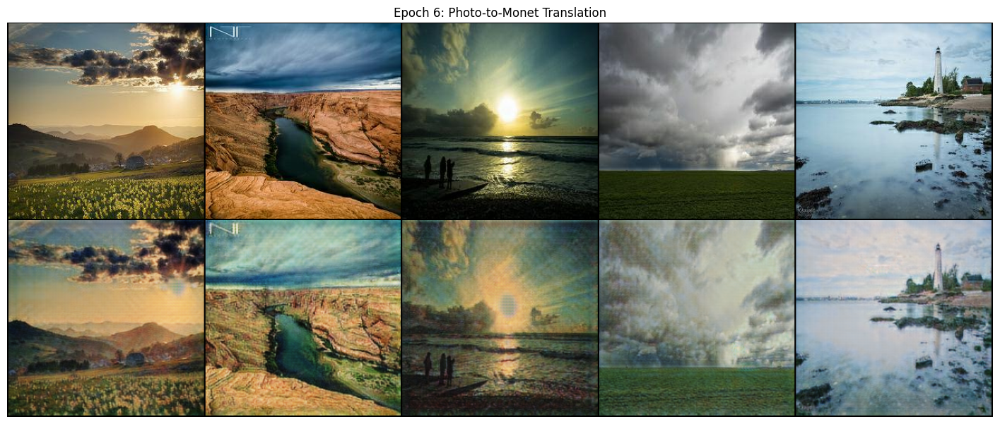

INFO:pytorch_lightning.utilities.rank_zero:Epoch 5, global step 84456: 'gen_loss' reached 5.29967 (best 5.29967), saving model to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/fullCTDA_monet-epoch=05-gen_loss=5.2997.ckpt' as top 3


Epoch 6 - lr: 0.00020 - gen_loss: 5.17983 - disc_loss_M: 0.15357 - disc_loss_P: 0.15776
Epoch 7 - lr: 0.00020 - gen_loss: 5.05518 - disc_loss_M: 0.16062 - disc_loss_P: 0.15550
Epoch 8 - lr: 0.00020 - gen_loss: 5.00681 - disc_loss_M: 0.15790 - disc_loss_P: 0.15833
Epoch 9 - lr: 0.00020 - gen_loss: 4.94182 - disc_loss_M: 0.15657 - disc_loss_P: 0.15586
Epoch 10 - lr: 0.00020 - gen_loss: 4.91171 - disc_loss_M: 0.15255 - disc_loss_P: 0.15282
Epoch 11 - lr: 0.00020 - gen_loss: 4.85057 - disc_loss_M: 0.14946 - disc_loss_P: 0.15575


Validation: |          | 0/? [00:00<?, ?it/s]

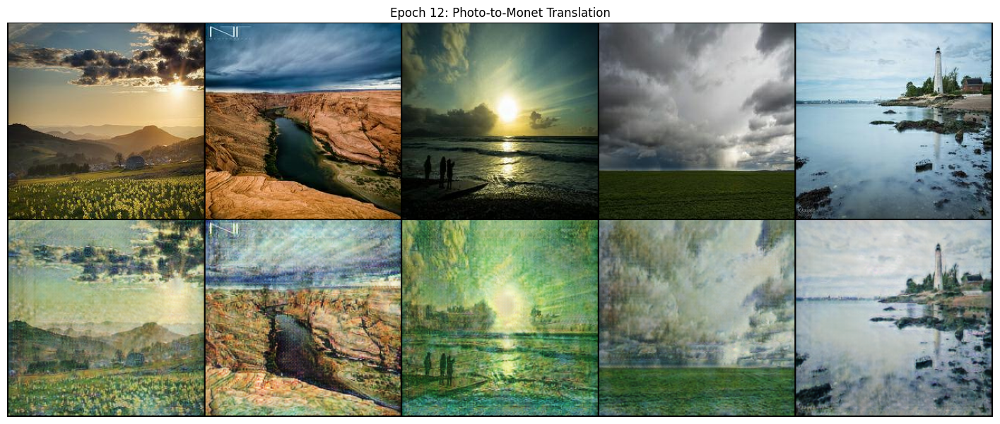

INFO:pytorch_lightning.utilities.rank_zero:Epoch 11, global step 168912: 'gen_loss' reached 4.85057 (best 4.85057), saving model to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/fullCTDA_monet-epoch=11-gen_loss=4.8506.ckpt' as top 3


Epoch 12 - lr: 0.00020 - gen_loss: 4.81563 - disc_loss_M: 0.14367 - disc_loss_P: 0.15466
Epoch 13 - lr: 0.00020 - gen_loss: 4.77622 - disc_loss_M: 0.14368 - disc_loss_P: 0.15565
Epoch 14 - lr: 0.00020 - gen_loss: 4.74105 - disc_loss_M: 0.14771 - disc_loss_P: 0.15447
Epoch 15 - lr: 0.00020 - gen_loss: 4.69577 - disc_loss_M: 0.14448 - disc_loss_P: 0.15265
Epoch 16 - lr: 0.00020 - gen_loss: 4.68834 - disc_loss_M: 0.14134 - disc_loss_P: 0.15180
Epoch 17 - lr: 0.00020 - gen_loss: 4.64514 - disc_loss_M: 0.13759 - disc_loss_P: 0.15247


Validation: |          | 0/? [00:00<?, ?it/s]

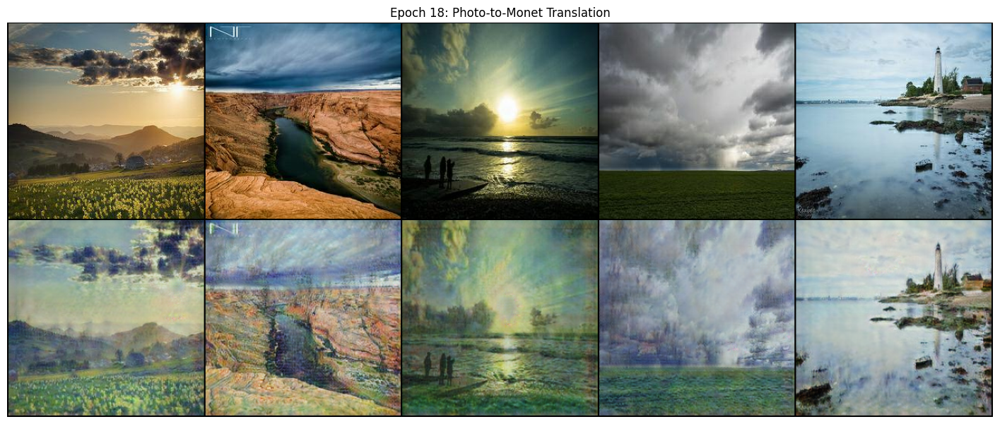

INFO:pytorch_lightning.utilities.rank_zero:Epoch 17, global step 253368: 'gen_loss' reached 4.64514 (best 4.64514), saving model to '/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/fullCTDA_monet-epoch=17-gen_loss=4.6451.ckpt' as top 3
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=18` reached.


Epoch 18 - lr: 0.00020 - gen_loss: 4.62860 - disc_loss_M: 0.13797 - disc_loss_P: 0.15364
Training ended.


In [ ]:
dm = CustomDataModule(**DM_CONFIG)
model = CycleGAN(**MODEL_CONFIG)
trainer = L.Trainer(
    callbacks=[checkpoint_callback],
    **TRAIN_CONFIG
)

trainer.fit(model, datamodule=dm)

### MiFID - ResNet full CTDA

#### Loading checkpoint from google drive

In [ ]:
model = CycleGAN.load_from_checkpoint(
    "/content/gdrive/MyDrive/ColabCheckpoints/monet_cyclegan/fullCTDA_monet-epoch=17-gen_loss=4.6451.ckpt",
    gen_name="resnet",
    num_resblocks=6,
    hid_channels=64,
    optimizer=torch.optim.Adam,
    lr=2e-4,
    betas=(0.5, 0.999),
    lambda_idt=0.5,
    lambda_cycle=(10, 10),
    buffer_size=100,
    num_epochs=18,
    decay_epochs=18
)
model.eval()

CycleGAN(
  (gen_PM): ResNetGenerator(
    (model): Sequential(
      (0): ReflectionPad2d((3, 3, 3, 3))
      (1): Downsampling(
        (block): Sequential(
          (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), bias=False)
          (1): InstanceNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (2): Downsampling(
        (block): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (3): Downsampling(
        (block): Sequential(
          (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (1): InstanceNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
          (2): ReLU(inplace=True)
        )
      )
      (4): Re

In [ ]:
mifid = MemorizationInformedFrechetInceptionDistance(normalize=True).cuda()

#### Loading to MiFID Monet images

In [ ]:
# MiFID expects [0,-1] range
target_dim = 256
transform_monet = T.Compose([
    T.Resize((target_dim, target_dim), antialias=True),
    T.ToTensor()
])
target_dim = 256
transform = T.Compose([
    T.Resize((target_dim, target_dim), antialias=True),
    T.ToTensor(),
    T.Normalize((0.5,), (0.5,))  # match CycleGAN training: [-1, 1] range
])

In [ ]:
monet_filenames = sorted(glob.glob(os.path.join("/content/monet_jpg", "*.jpg")))

for fname in monet_filenames:
    img = Image.open(fname).convert("RGB")
    img_tensor = transform_monet(img).unsqueeze(0).cuda()  # shape (1,3,H,W)
    mifid.update(img_tensor, real=True)

#### Loading to MiFID generated images

In [ ]:
output_path = r"/content/generated_monet_fullCTDA/"
os.mkdir(output_path)
photo_filenames = sorted(glob.glob(os.path.join("/content/photo_jpg", "*.jpg")))

for i,fname in enumerate(photo_filenames):
    img = Image.open(fname).convert("RGB")
    img_tensor = transform(img).unsqueeze(0).cuda()

    # Generate Monet-style image using your CycleGAN model
    with torch.no_grad():
        output = model.gen_PM(img_tensor)

    # Ensure output is in [0,1]
    output = (output + 1) / 2
    output = torch.clamp(output, 0, 1)

    save_image(output, f"{output_path}{os.path.basename(fname)}")

    mifid.update(output, real=False)

#### Calculate score

In [ ]:
score = mifid.compute()
print("MiFID score:", score.item())

MiFID score: 96.5000991821289


#### Save to zip in google drive

In [ ]:
!zip -r /content/generated_monet_fullCTDA.zip /content/generated_monet_fullCTDA/
!cp /content/generated_monet_fullCTDA.zip /content/gdrive/MyDrive/ColabCheckpoints/

Streaming output truncated to the last 5000 lines.
  adding: content/generated_monet_fullCTDA/5c50599656.jpg (deflated 2%)
  adding: content/generated_monet_fullCTDA/8f59672761.jpg (deflated 1%)
  adding: content/generated_monet_fullCTDA/5074e8a51e.jpg (deflated 1%)
  adding: content/generated_monet_fullCTDA/64bd39e960.jpg (deflated 1%)
  adding: content/generated_monet_fullCTDA/b46106fd89.jpg (deflated 2%)
  adding: content/generated_monet_fullCTDA/75979a026b.jpg (deflated 1%)
  adding: content/generated_monet_fullCTDA/3f8fd85f1c.jpg (deflated 1%)
  adding: content/generated_monet_fullCTDA/efd9e949f5.jpg (deflated 2%)
  adding: content/generated_monet_fullCTDA/95b6abfcee.jpg (deflated 1%)
  adding: content/generated_monet_fullCTDA/4a2c4db283.jpg (deflated 1%)
  adding: content/generated_monet_fullCTDA/c88254adbe.jpg (deflated 2%)
  adding: content/generated_monet_fullCTDA/759dcb713c.jpg (deflated 1%)
  adding: content/generated_monet_fullCTDA/803cdfa30d.jpg (deflated 1%)
  adding: con